In [1]:
import sys
import os
import time
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import odeint
import itertools


In [2]:
class Bacterial_population:
    def __init__(self, initial_pop_size, loci=1, psi_max_s=1, psi_min=-1, gamma=0.2, MIC = 1, cost_vector=[0], benefit_vector=[0], mutation_rate=0.001, living_style=0, biofilm_benefit=1, biofilm_cost=0.1, release_rate=0, adhesion_rate=0):
        
        ### define basic genetic parameters
        
        self.loci=loci
        self.psi_max_s=psi_max_s 
        self.psi_min=psi_min 
        self.gamma=gamma 

        self.cost_vector=cost_vector.copy()
        self.benefit_vector=benefit_vector.copy()
        self.mutation_rate=mutation_rate
        self.MIC=MIC
        self.population_sizes=[]
        
        ### lifestyle associated parameters
        self.living_style=living_style
        self.biofilm_benefit=biofilm_benefit
        self.biofilm_cost=biofilm_cost
        self.release_rate=release_rate
        self.adhesion_rate=adhesion_rate
        
        ## define initial pop sizes:
        if len(initial_pop_size)==2**loci:
            self.initial_pop_size=initial_pop_size.copy()
        elif  len(initial_pop_size)==1:
            self.initial_pop_size=np.zeros(2**loci)
            self.initial_pop_size[0]=initial_pop_size[0]
        else: 
            print ('problem with initial sizes')
        
        ### determine variables, genotypes and dependencies
        self.number_of_genotypes=2**loci
        self.genotypes=self.generate_genotypes()
        self.gen_shape = np.shape(self.genotypes)
        self.genotype_costs = 1 - np.prod(1 - (self.genotypes * (self.cost_vector)), axis=1)
        ### additive benefits:
        #self.genotype_benefits = np.dot(self.genotypes, self.benefit_vector)
        ## multiplicative  benefits
        self.genotype_benefits=np.prod((self.genotypes*(np.array(self.benefit_vector)-1))+1, axis=1)
        self.deps = self.define_dependencies()
        self.neg_deps = self.define_negative_dependencies()
        
        ### determine benefits
        if self.living_style==0: #this is for plankton
            #self.z_mic = self.MIC * (1 + (self.genotype_benefits) )  #this is for addititve
            self.z_mic = self.MIC * ( self.genotype_benefits )  ## this is for multiplicative
            self.total_cost=self.genotype_costs
            self.psi_max=self.psi_max_s*(1-self.total_cost)
        elif self.living_style==1: #this is for biofilm
            self.z_mic = self.MIC * (1 + (self.genotype_benefits) + self.biofilm_benefit) #this is for addititve
            self.z_mic = self.MIC * ((self.genotype_benefits) + self.biofilm_benefit)## this is for multiplicative
            self.total_cost=1-(1-self.genotype_costs)*(1-self.biofilm_cost)
            self.psi_max=self.psi_max_s*(1-self.total_cost)
        else:
            print ('error in defining living style')
        self.population_sizes.append(self.initial_pop_size)

    def generate_genotypes(self):
        ### generating all possible diploid genotypes (0-1 number of alleles) from the number of loci. 
        genotypes = np.empty([0, self.loci])
        for seq in itertools.product("01", repeat=self.loci):
            s = np.array(seq)
            s = list(map(int, s))
            genotypes = np.vstack([genotypes, s])
        return genotypes.astype(int)

    def define_dependencies(self):
        dependencies = []
        x_x = [2**i for i in range(self.gen_shape[1])]
        for i in range(self.gen_shape[0]):
            dependencies.append([])
            for j in x_x:
                sused = i ^ j
                if i > sused:
                    dependencies[i].append(sused)
        return (dependencies)

    def define_negative_dependencies(self):
        dependencies = []
        x_x = [2**i for i in range(self.gen_shape[1])]
        for i in range(self.gen_shape[0]):
            dependencies.append([])
            for j in x_x:
                sused = i ^ j
                if i < sused:
                    dependencies[i].append(sused)
        return (dependencies)


In [3]:
class Stochastic_utility():
    def __init__(self, population_pla, population_bio, my_treatment):
        print('initiated')
        self.tau=0.1
        self.stoich_mat=self.build_stoichiometric_matrix(population_pla.deps, population_pla.genotypes)
        current_population=np.concatenate((population_pla.initial_pop_size,population_bio.initial_pop_size))
        current_concentration=0
        self.propensities=self.calculate_propensities(current_population, my_treatment,population_pla, population_bio, current_concentration)
        
    def GillespieTauLeap(self, my_treatment, tau, V, y0, a_conc,population_pla, population_bio):
        '''N is the stoichiometry matrix
        rate function V. function that gives us the propensities as a function of the current state.
        V is the k reactivities or the equiibrium associations. Note V(y) gives the matrix we are looking for when starting the beginning of the algorithm.
        y0 is the initial condition/state vector.
        tlen is max length of time. We will build up to this.
        '''
        tlen=my_treatment.cycle_length
        N= self.stoich_mat
        t = 0.0  # starting time
        ts = [0.0]  # reporting array, to save information
        y = np.copy(y0)  # using the given initial condition
        # lists because these will be dynamically resizing bcs we will be randomly
        # choosing our time intervals. We could pre-allocate these in a np.array
        # to make more efficient.
        res = [list(y)]
        a_conc_array = [a_conc]
        while True:  # just continuously looping until there is a break from within
            #print ('time',t)
            a_conc_t = a_conc
            prop = V(y, a_conc_t)  # propensities
            a0 = sum(prop)  # to see total propensity
            if a0 == 0:
                print('propensities are 0')
                break
            dt = tau

            if t + dt > tlen:  # if waiting time will exceed time limit
                break
            for idx in range(len(prop)):
                how_many=np.random.poisson(prop[idx]*dt)  #this needs to be changed to poisson
                change_to_apply = how_many*N[:, idx]
                change_to_apply.shape = len(change_to_apply)  # converting to 1D array
                y += change_to_apply  # this is a np.array

            # Adding the time
            t += dt
            # saving the time and results so that we can use it later
            ts.append(t)
            res.append(list(y))
            a_conc_array.append(a_conc)
            
        ts=np.array(ts)
        a_conc_array=np.array(a_conc_array)
        return(ts, np.array(res), a_conc_array)
    
    def build_stoichiometric_matrix(self, deps, genotypes):
        no_genotypes = np.size(genotypes, 0)
        no_deps = int(np.sum(genotypes))
        mut_matrix = np.zeros([no_genotypes, no_deps])
        counter = 0
        for i in range(no_genotypes):
            #print (deps[i])
            for j in range(len(deps[i])):
                mut_matrix[deps[i][j], counter] = -1
                mut_matrix[i, counter] = 1
                counter += 1
        biofilm_release_matrix = np.zeros([2 * no_genotypes, no_genotypes])
        biofilm_adhesion_matrix = np.zeros([2 * no_genotypes, no_genotypes])
        
        for i in range(no_genotypes):
            biofilm_release_matrix[i, i] = 1
            biofilm_release_matrix[i + no_genotypes, i] = -1
            biofilm_adhesion_matrix[i, i] = -1
            biofilm_adhesion_matrix[i + no_genotypes, i] = 1

        stoich_matrix_simple = np.concatenate(
            (np.eye(no_genotypes), mut_matrix, -np.eye(no_genotypes)), axis=1)  # this is just
        # a very simple matrix of growth+mutation+death, for one type: either plankton or biofilm. To make the complete matrix,
        # we need to make it 4x larger, where 1_1 part and 2_2 quarants are these
        # simple ones, and the other quadrants are empty
        complete_stoich_top = np.concatenate(
            (stoich_matrix_simple, 0 * stoich_matrix_simple), axis=1)
        complete_stoich_bottom = np.concatenate(
            (0 * stoich_matrix_simple, stoich_matrix_simple), axis=1)
        complete_stoich = np.concatenate(
            (complete_stoich_top, complete_stoich_bottom), axis=0)
        # adding biofilm release
        complete_stoich = np.concatenate(
            (complete_stoich, biofilm_release_matrix, biofilm_adhesion_matrix), axis=1)
        return complete_stoich

    def calculate_propensities(self,y, my_treatment, population_pla, population_bio, current_concentration):
        K=my_treatment.car_cap
        kappa=my_treatment.kappa
        a_conc=current_concentration
        #y = np.copy(y0)
        #print ('this y shape', np.shape(y))
        y[y < 0] = 0
        all_y = np.sum(y)  # this is whole pop size
        reactions = []

        # Dealing with plankton
        gamma=population_pla.gamma
        psi_min=population_pla.psi_min
        mu=population_pla.mutation_rate
        deps=population_pla.deps
        z_mic=population_pla.z_mic

        ### some shit happening with psi, psi max aand gamma definitions!
        psi=population_pla.psi_max
        psi_max = psi * (1 - all_y / K) - gamma
        #print ('this is pla', z_mic, psi)
        
        # start with growth rates
        for i in range(int(len(y) / 2)):
            reactions.append(y[i] * psi[i] * (1 - all_y / K))  # seems ok

        # mutations
        for i in range(int(len(y) / 2)):
            for j in (deps[i]):
                reactions.append(mu * y[j] * psi[j] * (1 - all_y / K))  # seems ok
        # deaths
        for i in range(int(len(y) / 2)):
            reactions.append(y[i] *
                             (gamma +
                              (psi_max[i] -
                               psi_min) *
                              (a_conc /
                               z_mic[i]) ** kappa /
                              ((a_conc /
                                z_mic[i])**kappa -
                                  psi_min /
                                  psi_max[i])))
        # Dealing with biofilm
        gamma=population_bio.gamma
        psi_min=population_bio.psi_min
        mu=population_bio.mutation_rate
        deps=population_bio.deps
        z_mic=population_bio.z_mic

        ### some shit happening with psi, psi max aand gamma definitions!
        psi=population_bio.psi_max
        psi_max = psi * (1 - all_y / K) - gamma
        
        add_for_bio=population_pla.number_of_genotypes
        # start with growth rates
        for i in range(int(len(y) / 2)):
            reactions.append(y[i+add_for_bio] * psi[i] * (1 - all_y / K))  # seems ok

        # mutations
        for i in range(int(len(y) / 2)):
            for j in (deps[i]):
                reactions.append(mu * y[j+add_for_bio] * psi[j] * (1 - all_y / K))  # seems ok
        # deaths
        for i in range(int(len(y) / 2)):
            reactions.append(y[i+add_for_bio] *
                             (gamma +
                              (psi_max[i] -
                               psi_min) *
                              (a_conc /
                               z_mic[i]) ** kappa /
                              ((a_conc /
                                z_mic[i])**kappa -
                                  psi_min /
                                  psi_max[i])))
        # and no dealing with biofilm releasing cells and adhesion
        for i in range(int(len(y) / 2), len(y)):
            reactions.append(y[i] * population_pla.release_rate)  # seems ok
        for i in range(0,int(len(y) / 2)):
            reactions.append(y[i] * population_bio.adhesion_rate)  # seems ok
        return np.array(reactions)
    

In [4]:
class Treatment():
    ### definition of the treatment
    def __init__(self, concentration_gradient, cycle_length=24*60, cycle_number=1, car_cap=10**9,kappa=1.5, degradation_rate=0 ):
        
        self.concentration_gradient=concentration_gradient
        self.cycle_length=cycle_length
        self.cycle_number=cycle_number
        
        self.simulated_population_sizes=[]
        self.dilution_factor_record=[]
        self.car_cap=car_cap
        self.kappa=kappa
        self.degradation_rate=degradation_rate
        #self.simulated_population_sizes.append(population.population_sizes)
        #self.dilution_factor_record.append(0)
        self.time=[]#np.arange(self.cycle_number+1)*self.cycle_length
        
    def run_deterministic_simulation(self, population_pla, population_bio):
        print ('running deterministic simulation')
        self.concentration_record=[]
        self.pla_population_record=np.empty([0, population_pla.number_of_genotypes])
        self.bio_population_record=np.empty([0, population_bio.number_of_genotypes])
        
        starting_pla_pop=population_pla.population_sizes[0]
        starting_bio_pop=population_bio.population_sizes[0]
        self.time=[]
        for i in range (self.cycle_number):
            concentration=self.concentration_gradient[i]
            starting_pla_pop[starting_pla_pop<1]=0
            starting_bio_pop[starting_bio_pop<1]=0
            #self.simulated_population_sizes= np.append(a_conc, y_0)
            z_0=np.append(concentration,starting_pla_pop )
            z_0=np.append(z_0,starting_bio_pop)
            t = np.linspace(0, self.cycle_length, 1000)
            self.time=np.append(self.time, t+i*self.cycle_length)
            current_conc =concentration
            #print ('we are in cycle', i, 'at concentration', concentration, 'with z0',z_0)
            [my_z,infodict] = odeint(self.calculate_rates, z_0,t, 
                                args=(population_pla, population_bio, current_conc), full_output = 1)  
            this_conc=my_z[:,0]
            
            self.concentration_record=np.concatenate((self.concentration_record,this_conc ))
            this_pop_pla=my_z[:,1:population_pla.number_of_genotypes+1]
            self.pla_population_record=np.concatenate((self.pla_population_record,this_pop_pla))
            this_pop_bio=my_z[:,population_bio.number_of_genotypes+1:]
            self.bio_population_record=np.concatenate((self.bio_population_record,this_pop_bio))

            #dilution:
            dilution_coef_pla=np.sum(this_pop_pla[-1,:])/np.sum(starting_pla_pop)
            dilution_coef_bio=np.sum(this_pop_bio[-1,:])/np.sum(starting_bio_pop)
            
            if dilution_coef_pla<1:
                dilution_coef_pla=1
            if dilution_coef_bio<1:
                dilution_coef_bio=1
                
            starting_pla_pop = this_pop_pla[-1,:]/dilution_coef_pla
            starting_bio_pop = this_pop_bio[-1,:]/dilution_coef_bio

            
        self.final_populations=np.append(self.pla_population_record[-1,:],self.bio_population_record[-1,:])
       
    def calculate_rates(self, z,t,population_pla, population_bio, current_conc ) : ### still missing release rate!!!
        ############################## Antibiotic concentration #############
        current_conc=z[0]
        if current_conc<0:
            #print (current_conc)
            current_conc=0
            
        dcdt=[current_conc*self.degradation_rate]
        ############################## Population 0 (plankton) ###############
        
        pla_pop=z[1:population_pla.number_of_genotypes+1]
        pla_pop[pla_pop<0]=0
        
        bio_pop=z[population_pla.number_of_genotypes+1:]
        bio_pop[bio_pop<0]=0
        total_pop= np.sum(pla_pop)+np.sum(bio_pop)
        dydt_plankton=self.population_rates(population_pla,pla_pop,current_conc,total_pop )
        new_release=population_bio.release_rate*bio_pop
        dydt_plankton=dydt_plankton+new_release
        
        dydt_biofilm=self.population_rates(population_bio,bio_pop,current_conc,total_pop )
        new_adhesion=population_pla.adhesion_rate*pla_pop
        dydt_biofilm=dydt_biofilm+new_adhesion
        
        dzdt= np.append(dcdt,dydt_plankton)
        dzdt=np.append(dzdt, dydt_biofilm)  
        return dzdt
    
    def population_rates(self,population,this_pop,current_conc, total_pop):
                ############################## Population 1 (biofilm) ###############
        ############################## Psi a Psi max ###############
        #total_pop=np.sum(this_pop)
        
        # this is max growth rate
        
        pla_psi_max = population.psi_max_s * (1 - population.total_cost)*(1 - total_pop / self.car_cap) - population.gamma  # this is doubling rate
        growth = this_pop* pla_psi_max
        death = this_pop  * (population.gamma + (pla_psi_max - population.psi_min) * (current_conc / population.z_mic)
                                ** self.kappa / ((current_conc / population.z_mic)**self.kappa - population.psi_min /pla_psi_max))
        outgoing_mut = np.zeros(population.number_of_genotypes)
        incoming_mut = np.zeros(population.number_of_genotypes)

        this_neg_dep = np.array(population.neg_deps[0])
        outgoing_mut[0] = population.mutation_rate* growth[0] * len(this_neg_dep)
        
        for i in range(1, population.number_of_genotypes):
            this_dep = np.array(population.deps[i])
            this_neg_dep = np.array(population.neg_deps[i])
            outgoing_mut[i] = population.mutation_rate * growth[i] * len(this_neg_dep)
            incoming_mut[i] = population.mutation_rate* np.sum(growth[this_dep])

        dydt = growth - death + incoming_mut - outgoing_mut #+ release_rate * y_biofilm
        return dydt

    def plot_results(self, name=''):
        XX=name
        time=self.time/60
        plt.plot(time,self.concentration_record)
        plt.xlabel('time')
        plt.ylabel('concentration')
        plt.title('this is concentration')
        plt.show()

        plt.semilogy(time, self.pla_population_record)
        plt.xlabel('time')
        plt.ylabel('pop size')
        plt.title('this is plankton')
        plt.ylim([1,self.car_cap*1.5])
        #plt.savefig(XX+'Plankton.png',bbox_inches='tight')
        plt.show()

        plt.semilogy(time, self.bio_population_record)
        plt.title('this is biofilm')
        plt.xlabel('time')
        plt.ylabel('pop size')
        plt.ylim([1,self.car_cap*1.5])
        #plt.savefig(XX+'Biofilm.png',bbox_inches='tight')
        plt.show()      
        
        plt.semilogy(time, self.pla_population_record)
        plt.semilogy(time, self.bio_population_record,'--')
        plt.title('this is both')
        plt.xlabel('time')
        plt.ylabel('pop size')
        plt.ylim([1,self.car_cap*1.5])
        plt.savefig(XX+'Biofilm.png',bbox_inches='tight')
        plt.show()       
        
    def run_stochastic_simulation(self, population_pla, population_bio):
        print ('running stochastic simulation')
        stoch_sim=Stochastic_utility(population_pla, population_bio, self)
        print (stoch_sim.stoich_mat)
        tau=1
        
        self.concentration_record=[]
        self.pla_population_record=np.empty([0, population_pla.number_of_genotypes])
        self.bio_population_record=np.empty([0, population_bio.number_of_genotypes])

        starting_pla_pop=population_pla.population_sizes[0]
        starting_bio_pop=population_bio.population_sizes[0]
        self.time=[]
        
        for i in range (self.cycle_number):
            concentration=self.concentration_gradient[i]
            Vy = lambda y, a_conc: stoch_sim.calculate_propensities(y, self, population_pla, population_bio, concentration)
            starting_pla_pop[starting_pla_pop<1]=0
            starting_bio_pop[starting_bio_pop<1]=0
            #creating starting point pla and biofilms
            z_0=np.append(starting_pla_pop, starting_bio_pop )
            #print ('we are in cycle', i, 'at concentration', concentration, 'with z0',z_0)
            (ts, my_z, a_conc_array2)= stoch_sim.GillespieTauLeap(self, tau, Vy, z_0, concentration, population_pla, population_bio)
            this_pop_pla = my_z[:, 0:population_pla.number_of_genotypes ]
            this_pop_bio = my_z[:, population_pla.number_of_genotypes:]
            this_conc=[concentration]            
            self.time=np.append(self.time, ts+i*self.cycle_length)
            self.concentration_record=np.concatenate((self.concentration_record,a_conc_array2 ))
            self.pla_population_record=np.concatenate((self.pla_population_record,this_pop_pla))
            self.bio_population_record=np.concatenate((self.bio_population_record,this_pop_bio))
        
            #dilution:
            starting_pla_pop = this_pop_pla[-1,:]/100
            starting_bio_pop = this_pop_bio[-1,:]/100
        
        self.final_populations=np.append(self.pla_population_record[-1,:],self.bio_population_record[-1,:])
        print (self.pla_population_record)


In [194]:
class Analysis_functions():
    def __init__(self, name='test', loci=4):
        self.active=1
        self.loci=loci
        self.name=name
        print ('analysis active')
        
    def generate_genotypes(self):
        ### generating all possible diploid genotypes (0-1 number of alleles) from the number of loci. 
        self.genotypes = np.empty([0, self.loci])
        for seq in itertools.product("01", repeat=self.loci):
            s = np.array(seq)
            s = list(map(int, s))
            self.genotypes = np.vstack([self.genotypes, s])

    def genMeanMutNum(self,time, pop, k=4):
        self.generate_genotypes()
        sum_mut=np.sum(self.genotypes,1)
        weighted_pops=pop*sum_mut
        #mean_mut2=np.sum(weighted_pops,1)/np.sum(pop,1)
        a=np.sum(weighted_pops,1)
        b=np.sum(pop,1)
        #mean_mut=np.divide(a,b, out=np.zeros_like(a), where=b!=0)
        mean_mut=a/b#(a,b, out=np.zeros_like(a), where=b!=0)
        #plt.plot(time, mean_mut)
        return (mean_mut)

    def plot_total_populations(self, N=1):
        name0=self.name
        fin_pops=np.zeros(32)
        for my_id in range(N):
            name=name0+'pla'
            name_pla_pop=name+'pla_pop'+str(my_id)+'.npy'
            name_time=name+'time'+str(my_id)+'.npy'
            name_conc=name+'conc'+str(my_id)+'.npy'
            time=np.load(name_time)
            time=time/60  
            pla_pops=np.load(name_pla_pop)
            plt.semilogy(time, np.sum(pla_pops,1), color='cyan', alpha=0.2)
            plt.ylim([1,2*10**9])
            #get_final_pops(self, -1, pla_pops,k=4)
         
        for my_id in range(N):
            name=name0+'bio'
            name_bio_pop=name+'bio_pop'+str(my_id)+'.npy'
            name_time=name+'time'+str(my_id)+'.npy'
            name_conc=name+'conc'+str(my_id)+'.npy'
            time=np.load(name_time)
            time=time/60  
            bio_pops=np.load(name_bio_pop)
            #print (np.shape(bio_pops))
            #print (np.shape(np.sum(bio_pops,1)))
            plt.semilogy(time,np.sum(bio_pops,1) , ':m', linewidth=2, alpha=0.1)
            plt.ylim([1,2*10**9])
            #get_final_pops(self, -1, pla_pops,k=4)
        plt.xlim([180,500])
        
        plt.xlabel('time [h]', fontsize=15)
        plt.ylabel('population size', fontsize=15)
        plt.savefig(name0+'Popsize.png',dpi=200,bbox_inches='tight')
        
        plt.show()
        name_conc=name+'conc'+str(my_id)+'.npy'
        #time=np.load(name_time)
        conc=np.load(name_conc)
        plt.xlim([180,500])
        plt.plot(time, conc, color='red',linewidth=2 )
        plt.xlabel('time [h]', fontsize=15)
        plt.ylabel('concentration', fontsize=15)
        plt.savefig(name0+'Conc.png',dpi=200,bbox_inches='tight')
    
    def get_final_pops(self, time, pop,k=4):
        [t,phe]=np.shape(pop)
        sizes=np.zeros(phe)
        print ('this is last time', time[-1])

        if time[-1]<576:
            print ('dead')
        else:
            sizes=pop[-1,:]
        return(sizes)  
    
    def get_composition(self, N=1):
        name0=self.name
        fin_pops=np.zeros(32)
        for my_id in range(N):
            name=name0+'bio'
            name_bio_pop=name+'bio_pop'+str(my_id)+'.npy'
            name_time=name+'time'+str(my_id)+'.npy'
            name_conc=name+'conc'+str(my_id)+'.npy'
            time=np.load(name_time)
            time=time/60  
            bio_pops=np.load(name_bio_pop)
            final_pops=self.get_final_pops(time, bio_pops,k=4)
            print (final_pops)
            #print (np.shape(bio_pops))
            #print (np.shape(np.sum(bio_pops,1)))
            #plt.semilogy(time,np.sum(bio_pops,1) , color='green', linewidth=2, alpha=0.1)
            plt.ylim([1,2*10**9])
            #get_final_pops(self, -1, pla_pops,k=4)
        plt.xlim([180,500])
        
    def plot_average_mutation_number(self, N=1):
        fig1, ax1 = plt.subplots(dpi=2000)
        plt.axvline(x=12, color='red', linestyle='-', linewidth=84, alpha=0.05)
        plt.axvline(x=36, color='red', linestyle='-', linewidth=84, alpha=0.1)
        plt.axvline(x=60, color='red', linestyle='-', linewidth=84, alpha=0.15)
        plt.axvline(x=84, color='red', linestyle='-', linewidth=84, alpha=0.2)
        plt.rc('xtick', labelsize=12) 
        plt.rc('ytick', labelsize=12) 
        name0=self.name
        fin_pops=np.zeros(32)
        for my_id in range(N):
            name=name0+'pla'
            name_pla_pop=name+'pla_pop'+str(my_id)+'.npy'
            name_time=name+'time'+str(my_id)+'.npy'
            name_conc=name+'conc'+str(my_id)+'.npy'
            pla_pops=np.load(name_pla_pop)
            time=np.load(name_time)
            time=time/60  
            concentration=np.load(name_conc)
            pla_mean_mut_num=self.genMeanMutNum(time, pla_pops, k=4)
            plt.plot(time, pla_mean_mut_num,'c', linewidth=2, alpha=0.08)
        #plt.xlim([0,96])
        #plt.ylim([0,4.1])
        #plt.savefig(name0+'pla.png',dpi=200,bbox_inches='tight')
        #plt.show()
        for my_id in range(N):
            name=name0+'bio'
            name_bio_pop=name+'bio_pop'+str(my_id)+'.npy'
            name_time=name+'time'+str(my_id)+'.npy'
            name_conc=name+'conc'+str(my_id)+'.npy'
            bio_pops=np.load(name_bio_pop)
            time=np.load(name_time)
            time=time/60  
            concentration=np.load(name_conc)
            bio_mean_mut_num=self.genMeanMutNum(time, bio_pops, k=4)
            plt.plot(time, bio_mean_mut_num, ':m', linewidth=2, alpha=0.08)
            

        plt.xlabel('time [h]', fontsize=15)
        plt.ylabel('number of mutations', fontsize=15)
        #ax1.yaxis.set_major_formatter(formatter) 
        #plt.savefig(savename0+'MutNumT2.png', dpi=200,bbox_inches='tight')
        #plt.show()
        plt.xlim([0,96])
        plt.ylim([-0.1,4.1])
        plt.savefig(name0+'both.png',dpi=200,bbox_inches='tight')
        plt.show()

        fig1, ax1 = plt.subplots(dpi=2000)
        plt.axvline(x=12, color='red', linestyle='-', linewidth=84, alpha=0.05)
        plt.axvline(x=36, color='red', linestyle='-', linewidth=84, alpha=0.1)
        plt.axvline(x=60, color='red', linestyle='-', linewidth=84, alpha=0.15)
        plt.axvline(x=84, color='red', linestyle='-', linewidth=84, alpha=0.2)
        plt.rc('xtick', labelsize=12) 
        plt.rc('ytick', labelsize=12) 
        for my_id in range(N):
            name=name0+'bio'
            print (my_id)
            name_bio_pop=name+'bio_pop'+str(my_id)+'.npy'
            print (name_bio_pop)
            name_time=name+'time'+str(my_id)+'.npy'
            name_conc=name+'conc'+str(my_id)+'.npy'
            bio_pops=np.load(name_bio_pop)
            time=np.load(name_time)
            time=time/60  
            concentration=np.load(name_conc)
            bio_mean_mut_num=self.genMeanMutNum(time, bio_pops, k=4)
            plt.plot(time, bio_mean_mut_num, ':m', linewidth=2, alpha=0.08)
            

        plt.xlabel('time [h]', fontsize=15)
        plt.ylabel('number of mutations', fontsize=15)
        #ax1.yaxis.set_major_formatter(formatter) 
        #plt.savefig(savename0+'MutNumT2.png', dpi=200,bbox_inches='tight')
        #plt.show()
        plt.xlim([0,96])
        plt.ylim([-0.001,0.04])
        plt.savefig(name0+'bio.png',dpi=200,bbox_inches='tight')
        plt.show()

        print ('done')
        return(fin_pops/N)
        
    def plot_some_dynamics(self, N=1):
        fig, ax = plt.subplots(dpi=2000)
        #ax.set_prop_cycle('color', [plt.cm.winter(i) for i in np.linspace(0, 1, 2**4)])
        ax.set_prop_cycle('color', [plt.cm.jet(j) for j in np.linspace(0, 1, 2**4)])
        name0=self.name
        fin_pops=np.zeros(32)
        for my_id in range(N):
            name=name0+'pla'
            name_pla_pop=name+'pla_pop'+str(my_id)+'.npy'
            name_time=name+'time'+str(my_id)+'.npy'
            name_conc=name+'conc'+str(my_id)+'.npy'
            time=np.load(name_time)
            time=time/60  
            pla_pops=np.load(name_pla_pop)
            plt.semilogy(time, pla_pops,  alpha=0.2)
            plt.ylim([1,2*10**9])
            #get_final_pops(self, -1, pla_pops,k=4)
        #plt.xlim([180,500])
        plt.xlim([0,500])
        plt.xlabel('time [h]', fontsize=15)
        plt.ylabel('population size', fontsize=15)
        plt.savefig(name0+'PopsizeAllPla.png',dpi=200,bbox_inches='tight')
        plt.show()
        fig, ax = plt.subplots(dpi=2000)
        ax.set_prop_cycle('color', [plt.cm.jet(j) for j in np.linspace(0, 1, 2**4)])
        for my_id in range(N):
            name=name0+'bio'
            name_bio_pop=name+'bio_pop'+str(my_id)+'.npy'
            name_time=name+'time'+str(my_id)+'.npy'
            name_conc=name+'conc'+str(my_id)+'.npy'
            time=np.load(name_time)
            time=time/60  
            bio_pops=np.load(name_bio_pop)
            #print (np.shape(bio_pops))
            #print (np.shape(np.sum(bio_pops,1)))
            plt.semilogy(time,(bio_pops) , linewidth=1, alpha=0.1)
            plt.ylim([1,2*10**9])
            #get_final_pops(self, -1, pla_pops,k=4)
        plt.xlim([0,500])
        plt.xlabel('time [h]', fontsize=15)
        plt.ylabel('population size', fontsize=15)
        plt.savefig(name0+'PopsizeAllBio.png',dpi=200,bbox_inches='tight')
        plt.show()
        name_conc=name+'conc'+str(my_id)+'.npy'
        conc=np.load(name_conc)
        plt.xlim([0,500])
        plt.plot(time, conc, color='red',linewidth=1 )
        plt.xlabel('time [h]', fontsize=15)
        plt.ylabel('concentration', fontsize=15)
        plt.savefig(name0+'Conc.png',dpi=200,bbox_inches='tight')    


## Experiment 0
This is just to test functions. 


plankton: [ 1.  4.  3. 12.  2.  8.  6. 24.]
biofilm: [ 6.  9.  8. 17.  7. 13. 11. 29.]
running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
[[100. 100.   0. ...   0.   0.   0.]
 [102. 104.   0. ...   0.   0.   0.]
 [103. 107.   0. ...   0.   0.   0.]
 ...
 [  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.   0. ...   0.   0.   0.]]


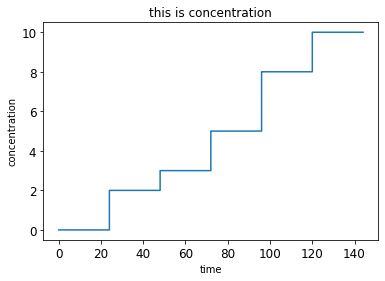

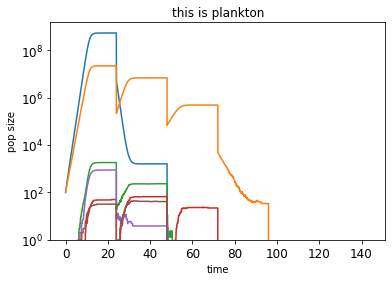

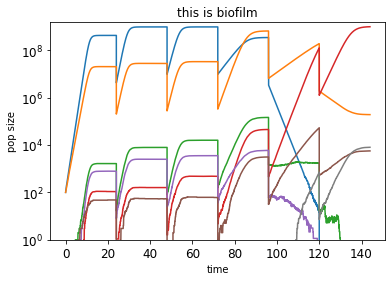

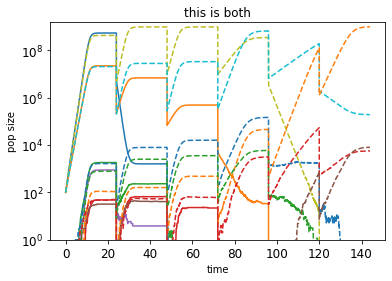

running deterministic simulation


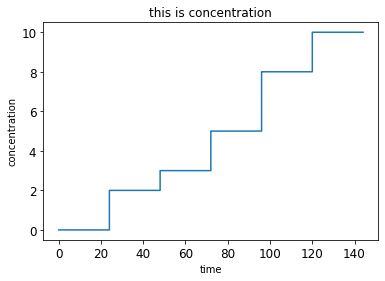

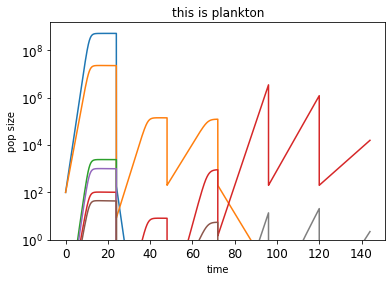

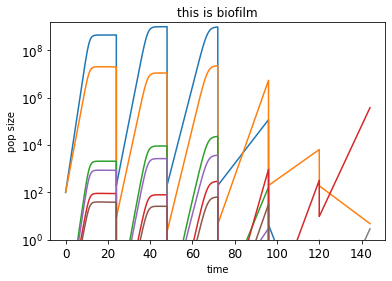

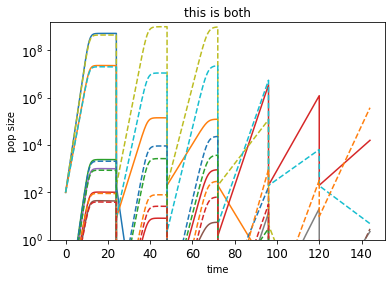

In [90]:
def run_experiment_0(name='experiment'):
    

    ####### GENERAL PROPERTIES OF THE POPULATION ########
    loci=3
    mutation_rate=0.0000010
    cost_vector=[0.5,0.2,0.2]   #loc_costs = 0 * c_c * np.random.rand(k) + c_c
    benefit_vector=[2,3,4]  
    biofilm_benefit=5
    biofilm_cost=0.01
    psi_max_s=0.0231 
    psi_min=-0.0833
    gamma=0.00007
    release_rate=0#0.1
    adhesion_rate=0#0.1##0.00000001

    MIC = 1.0
    ##############################

    init_pop=np.zeros(2**loci)
    car_cap=10**9
    
    ######### PROPERTIES OF THE EXPERIMENT, INCLUDING THE DRUG PARAMETERS #######
    #### non of this matters for the red and green experiement?
    kappa=1.5
    cycle_length = 24 * 60  # length of a cycle in minutes
    init_conc = 0.0 * MIC  # intitial antibiotic concentration
    
    degradation_rate=0#-0.000004
    concentration_gradient=[0,2,3,5,8,10]
    cycle_number=len(concentration_gradient)
    
    
    ########## SPECIFICS OF THIS EXPERIMENT #####################################
    ############ Starting population initialization  ###############

    living_style=0
    init_pop=np.zeros(2**loci)
    init_pop[0]=100  #
    init_pop[1]=100  #
    my_pla_population=Bacterial_population(init_pop,loci=loci,psi_max_s=psi_max_s, psi_min=psi_min, gamma=gamma, MIC = MIC, cost_vector=cost_vector,benefit_vector=benefit_vector, mutation_rate=mutation_rate, living_style=living_style, biofilm_benefit=biofilm_benefit, biofilm_cost=biofilm_cost, release_rate=release_rate, adhesion_rate=adhesion_rate)
    my_pla_population2=Bacterial_population(init_pop,loci=loci,psi_max_s=psi_max_s, psi_min=psi_min, gamma=gamma, MIC = MIC, cost_vector=cost_vector,benefit_vector=benefit_vector, mutation_rate=mutation_rate, living_style=living_style, biofilm_benefit=biofilm_benefit, biofilm_cost=biofilm_cost, release_rate=release_rate, adhesion_rate=adhesion_rate)
    print ('plankton:', my_pla_population.z_mic)
    # Define Biofilm population - it is empty

    living_style=1
    init_pop=np.zeros(2**loci)
    init_pop[0]=100
    init_pop[1]=100
    my_bio_population=Bacterial_population(init_pop,loci=loci,psi_max_s=psi_max_s, psi_min=psi_min, gamma=gamma, MIC = MIC, cost_vector=cost_vector,benefit_vector=benefit_vector, mutation_rate=mutation_rate, living_style=living_style, biofilm_benefit=biofilm_benefit, biofilm_cost=biofilm_cost, release_rate=release_rate, adhesion_rate=adhesion_rate)
    my_bio_population2=Bacterial_population(init_pop,loci=loci,psi_max_s=psi_max_s, psi_min=psi_min, gamma=gamma, MIC = MIC, cost_vector=cost_vector,benefit_vector=benefit_vector, mutation_rate=mutation_rate, living_style=living_style, biofilm_benefit=biofilm_benefit, biofilm_cost=biofilm_cost, release_rate=release_rate, adhesion_rate=adhesion_rate)
    print ('biofilm:', my_bio_population.z_mic)
    #Run this 
    
    my_treatment=Treatment(concentration_gradient, cycle_length=cycle_length , cycle_number=cycle_number, car_cap=car_cap,kappa=kappa, degradation_rate=degradation_rate)
    my_treatment2=Treatment(concentration_gradient, cycle_length=cycle_length , cycle_number=cycle_number, car_cap=car_cap,kappa=kappa, degradation_rate=degradation_rate)
    my_treatment.run_stochastic_simulation(my_pla_population, my_bio_population)
    my_treatment.plot_results() 
    
    #plt.semilogy(my_treatment.pla_population_record)
    #plt.title('plankton')
    #plt.show()
    #plt.semilogy(my_treatment.bio_population_record, ':')
    #plt.title('biofilm')
    #plt.legend(['pla g', 'pla r', 'bio g', 'bio r'])
    #plt.show()
    
    my_treatment2.run_deterministic_simulation(my_pla_population2, my_bio_population2)
    my_treatment2.plot_results() 
    #np.save(name,complete_dynamics)
    
    return (my_treatment.final_populations)


test=run_experiment_0(name='test')

# Experiment SlowDown Evolution

Here I will run an experiment for combination of factors showing that evolution is slowed down. 



In [7]:
def run_experiment_SlowDown(name='experiment', N=1):
    

    ####### GENERAL PROPERTIES OF THE POPULATION ########
    loci=4
    mutation_rate=0.0001
    cost_vector=[0.1,0.1,0.1,0.1]   #loc_costs = 0 * c_c * np.random.rand(k) + c_c
    benefit_vector=[2,2,2,2]  
    biofilm_benefit=10
    biofilm_cost=0.2
    
    psi_max_s=0.0231 
    psi_min=-0.0833
    gamma=0.00007
    release_rate=0#0.1
    adhesion_rate=0#0.1##0.00000001

    MIC = 1.0
    ##############################

    init_pop=np.zeros(2**loci)
    car_cap=10**9
    
    ######### PROPERTIES OF THE EXPERIMENT, INCLUDING THE DRUG PARAMETERS #######
    #### non of this matters for the red and green experiement?
    kappa=1.5
    cycle_length = 24 * 60  # length of a cycle in minutes
    init_conc = 0.0 * MIC  # intitial antibiotic concentration
    
    degradation_rate=0#-0.000004
    concentration_gradient=[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24]
    cycle_number=len(concentration_gradient)
    
    
    ########## SPECIFICS OF THIS EXPERIMENT #####################################
    ############ Starting population initialization  ###############
    
    #Run stochastic simulations

    ############## RUN ONLY FOR PLANKTON ################
    for i in range (N):
        name_pla=name+'pla'
        living_style=1
        init_pop=np.zeros(2**loci)
        
        ##here I create empty biofilm population and wild type plnkton
        my_bio_population=Bacterial_population(init_pop,loci=loci,psi_max_s=psi_max_s, psi_min=psi_min, gamma=gamma, MIC = MIC, cost_vector=cost_vector,benefit_vector=benefit_vector, mutation_rate=mutation_rate, living_style=living_style, biofilm_benefit=biofilm_benefit, biofilm_cost=biofilm_cost, release_rate=release_rate, adhesion_rate=adhesion_rate)
        
        living_style=0
        init_pop[0]=1000000  #
        my_pla_population=Bacterial_population(init_pop,loci=loci,psi_max_s=psi_max_s, psi_min=psi_min, gamma=gamma, MIC = MIC, cost_vector=cost_vector,benefit_vector=benefit_vector, mutation_rate=mutation_rate, living_style=living_style, biofilm_benefit=biofilm_benefit, biofilm_cost=biofilm_cost, release_rate=release_rate, adhesion_rate=adhesion_rate)
        
        my_treatment=Treatment(concentration_gradient, cycle_length=cycle_length , cycle_number=cycle_number, car_cap=car_cap,kappa=kappa, degradation_rate=degradation_rate)
        my_treatment.run_stochastic_simulation(my_pla_population, my_bio_population)
        print ('plotting results, only pla should be present')
        my_treatment.plot_results() 

        this_name=(name_pla+'pla_pop'+str(i))
        np.save(this_name,my_treatment.pla_population_record )
        this_name=(name_pla+'bio_pop'+str(i))
        np.save(this_name,my_treatment.bio_population_record )
        this_name=(name_pla+'time'+str(i))
        np.save(this_name,my_treatment.time )
        this_name=(name_pla+'conc'+str(i))
        np.save(this_name,my_treatment.concentration_record)

    ############## RUN ONLY FOR PLANKTON ################
    for i in range (N):
        name_bio=name+'bio'
        living_style=0
        init_pop=np.zeros(2**loci)
        my_pla_population=Bacterial_population(init_pop,loci=loci,psi_max_s=psi_max_s, psi_min=psi_min, gamma=gamma, MIC = MIC, cost_vector=cost_vector,benefit_vector=benefit_vector, mutation_rate=mutation_rate, living_style=living_style, biofilm_benefit=biofilm_benefit, biofilm_cost=biofilm_cost, release_rate=release_rate, adhesion_rate=adhesion_rate)

        living_style=1
        init_pop=np.zeros(2**loci)
        init_pop[0]=100000
        my_bio_population=Bacterial_population(init_pop,loci=loci,psi_max_s=psi_max_s, psi_min=psi_min, gamma=gamma, MIC = MIC, cost_vector=cost_vector,benefit_vector=benefit_vector, mutation_rate=mutation_rate, living_style=living_style, biofilm_benefit=biofilm_benefit, biofilm_cost=biofilm_cost, release_rate=release_rate, adhesion_rate=adhesion_rate)

        my_treatment=Treatment(concentration_gradient, cycle_length=cycle_length , cycle_number=cycle_number, car_cap=car_cap,kappa=kappa, degradation_rate=degradation_rate)
        my_treatment.run_stochastic_simulation(my_pla_population, my_bio_population)
        print ('plotting results, only bio should be present')
        my_treatment.plot_results() 

        this_name=(name_bio+'pla_pop'+str(i))
        np.save(this_name,my_treatment.pla_population_record )
        this_name=(name_bio+'bio_pop'+str(i))
        np.save(this_name,my_treatment.bio_population_record )
        this_name=(name_bio+'time'+str(i))
        np.save(this_name,my_treatment.time )
        this_name=(name_bio+'conc'+str(i))
        np.save(this_name,my_treatment.concentration_record)

    

    #Run deterministic simulations
    #my_bio_population2=Bacterial_population(init_pop,loci=loci,psi_max_s=psi_max_s, psi_min=psi_min, gamma=gamma, MIC = MIC, cost_vector=cost_vector,benefit_vector=benefit_vector, mutation_rate=mutation_rate, living_style=living_style, biofilm_benefit=biofilm_benefit, biofilm_cost=biofilm_cost, release_rate=release_rate, adhesion_rate=adhesion_rate)
    #my_treatment2=Treatment(concentration_gradient, cycle_length=cycle_length , cycle_number=cycle_number, car_cap=car_cap,kappa=kappa, degradation_rate=degradation_rate)
    #my_treatment2.run_deterministic_simulation(my_pla_population2, my_bio_population2)
    #my_treatment2.plot_results() 
    #np.save(name,complete_dynamics)
    
    return (my_treatment.final_populations)


running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
[[1.00000e+06 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [9.99760e+05 1.00000e+00 6.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [9.99908e+05 4.00000e+00 7.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 ...
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]]
plotting results, only pla should be present


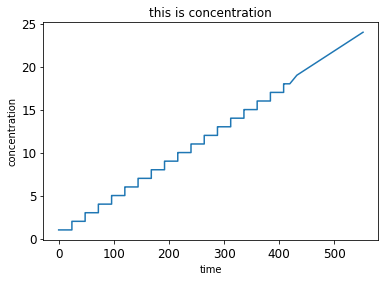

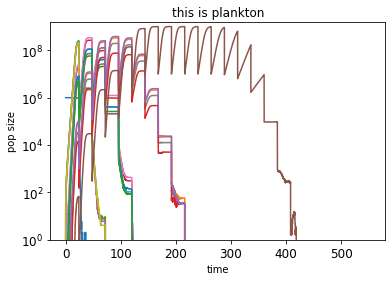

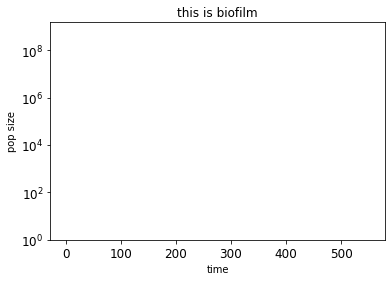

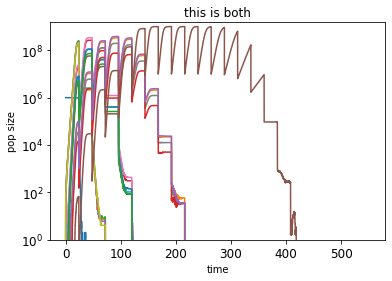

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
[[1.000000e+06 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [1.000203e+06 1.000000e+00 5.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [9.999760e+05 4.000000e+00 8.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]]
plotting results, only pla should be present


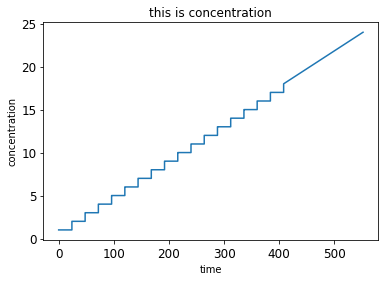

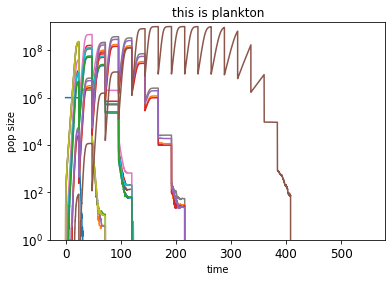

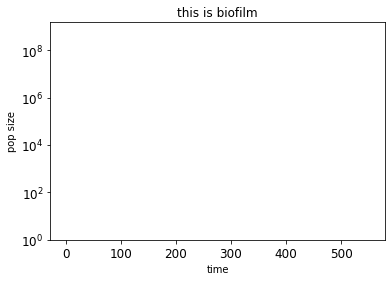

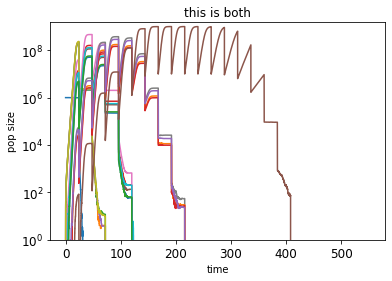

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
[[1.000000e+06 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [1.000399e+06 4.000000e+00 4.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [1.000499e+06 5.000000e+00 8.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]]
plotting results, only pla should be present


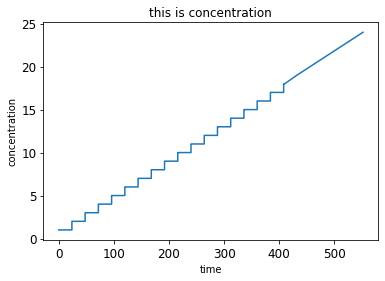

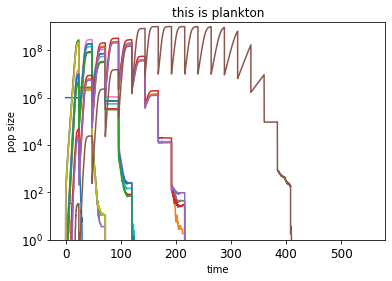

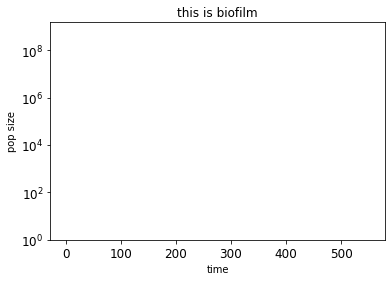

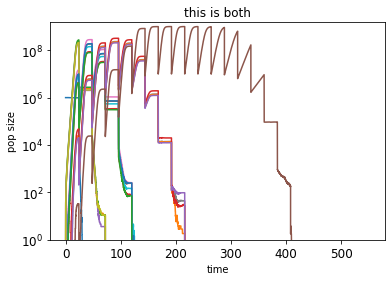

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
[[1.000000e+06 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [1.000202e+06 2.000000e+00 2.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [1.000052e+06 1.000000e+01 6.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]]
plotting results, only pla should be present


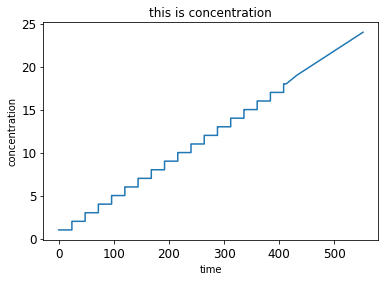

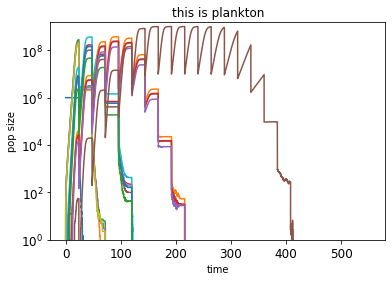

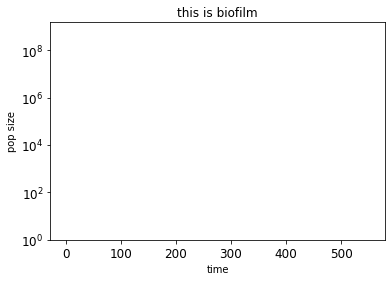

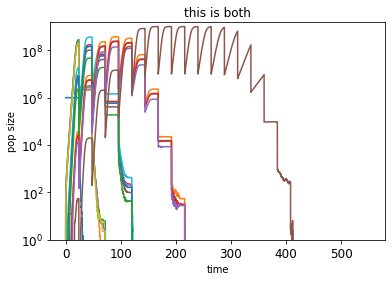

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
[[1.00000e+06 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [9.99763e+05 0.00000e+00 5.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [9.99854e+05 2.00000e+00 8.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 ...
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]]
plotting results, only pla should be present


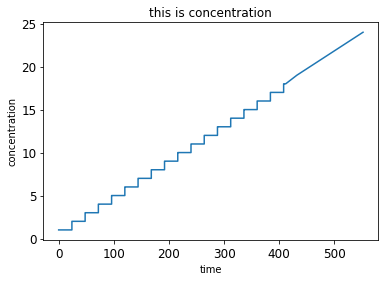

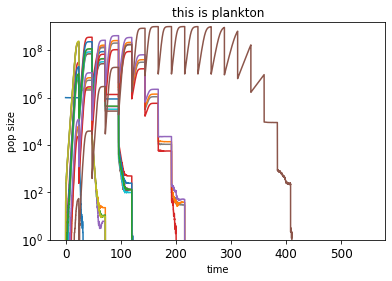

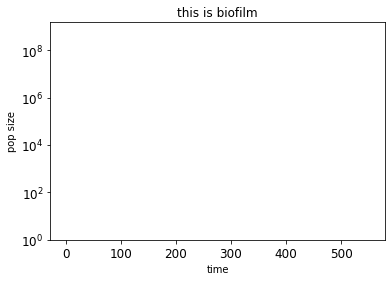

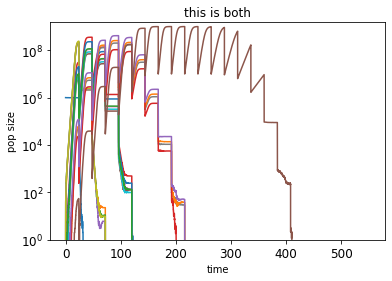

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
[[1.000000e+06 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [1.000247e+06 5.000000e+00 2.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [1.000461e+06 7.000000e+00 3.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]]
plotting results, only pla should be present


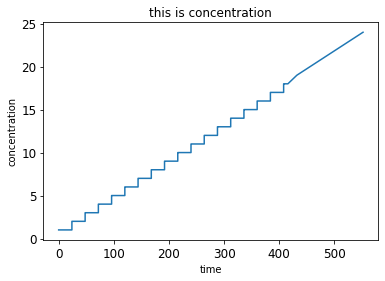

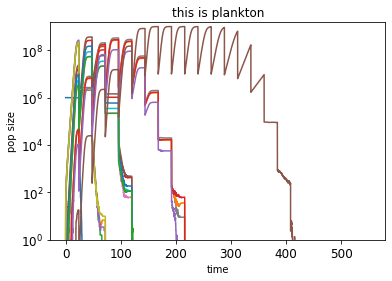

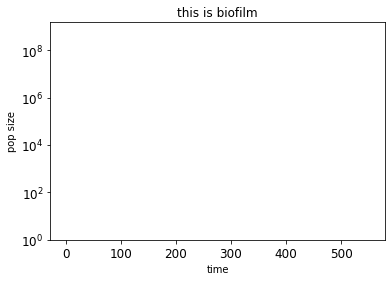

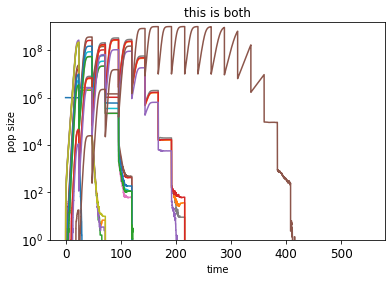

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
[[1.000000e+06 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [9.999580e+05 4.000000e+00 4.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [1.000252e+06 7.000000e+00 5.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]]
plotting results, only pla should be present


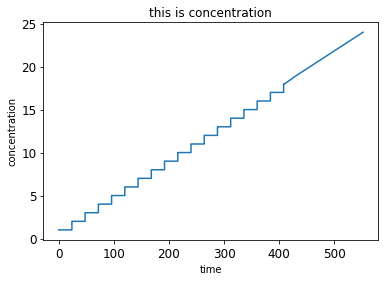

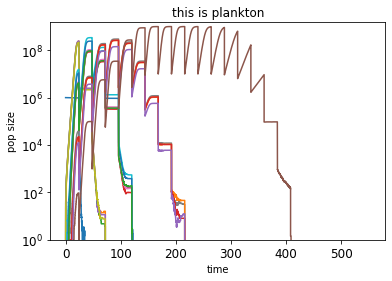

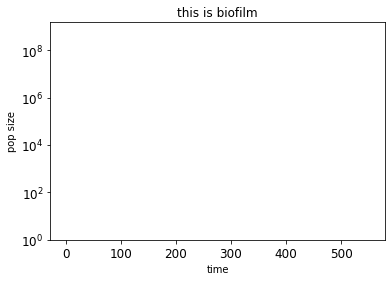

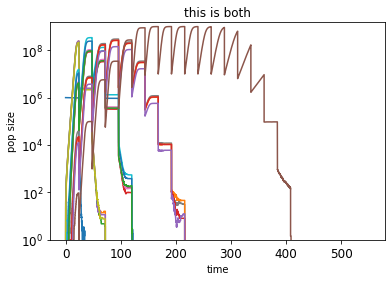

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
[[1.00000e+06 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [9.99990e+05 1.00000e+00 2.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [9.99951e+05 3.00000e+00 5.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 ...
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]]
plotting results, only pla should be present


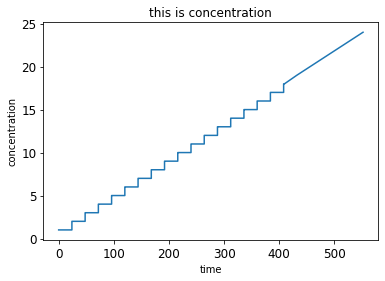

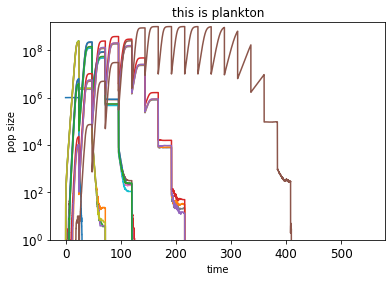

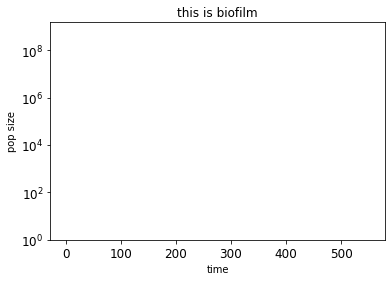

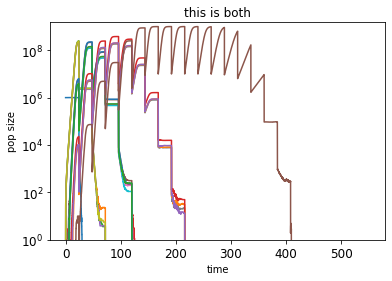

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
[[1.00000e+06 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [9.99856e+05 1.00000e+00 3.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [9.99666e+05 5.00000e+00 4.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 ...
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]]
plotting results, only pla should be present


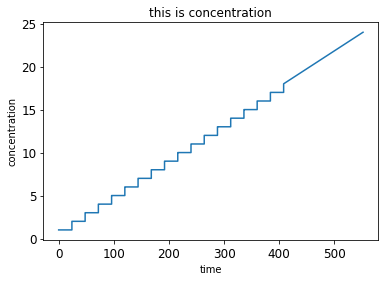

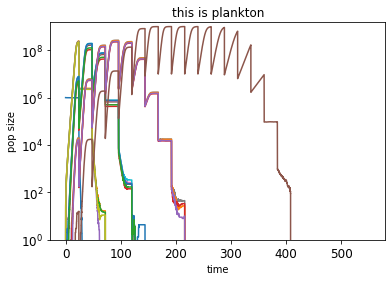

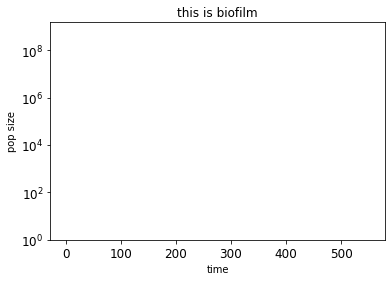

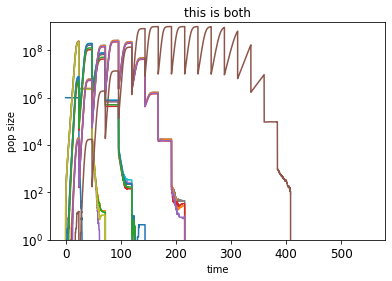

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
[[1.000000e+06 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [1.000078e+06 0.000000e+00 5.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [1.000567e+06 2.000000e+00 6.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]]
plotting results, only pla should be present


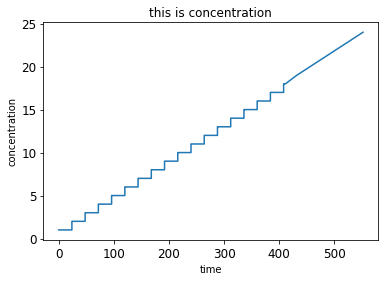

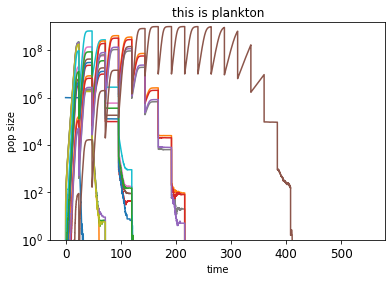

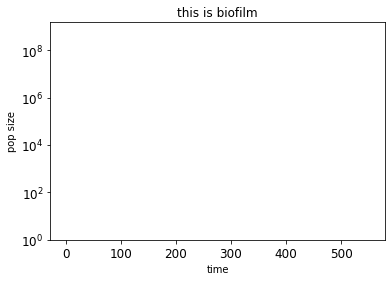

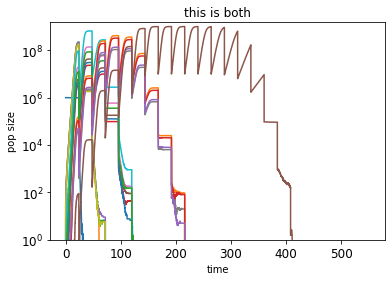

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
[[1.000000e+06 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [1.000139e+06 2.000000e+00 3.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [1.000310e+06 8.000000e+00 4.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]]
plotting results, only pla should be present


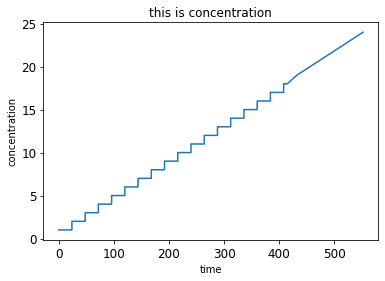

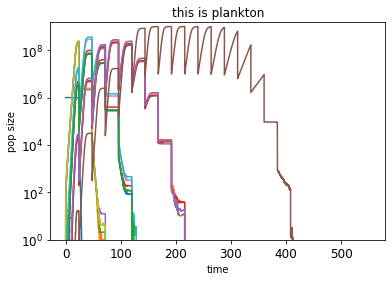

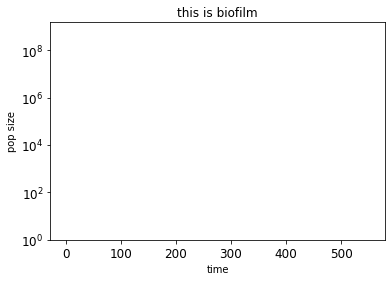

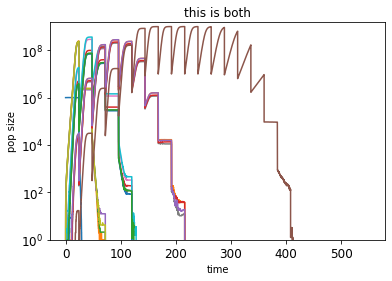

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
[[1.000000e+06 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [1.000129e+06 5.000000e+00 1.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [1.000343e+06 7.000000e+00 2.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]]
plotting results, only pla should be present


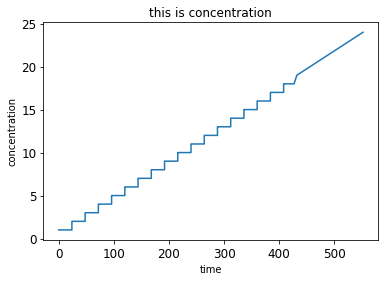

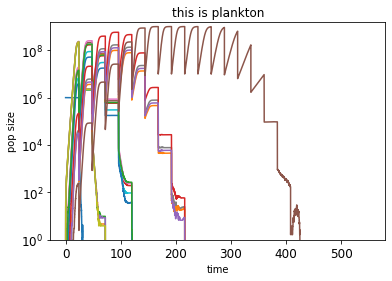

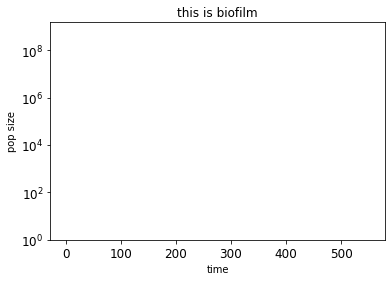

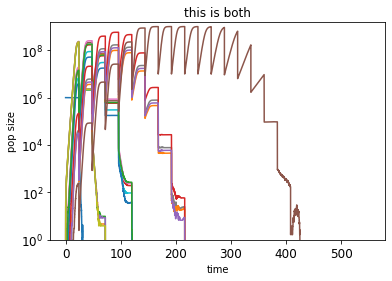

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
[[1.00000e+06 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [9.99956e+05 3.00000e+00 2.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [9.99997e+05 8.00000e+00 3.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 ...
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]]
plotting results, only pla should be present


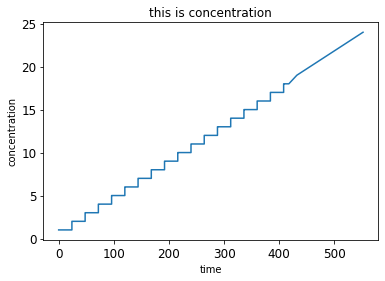

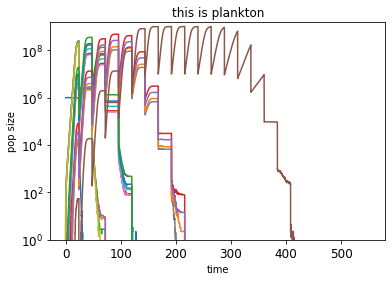

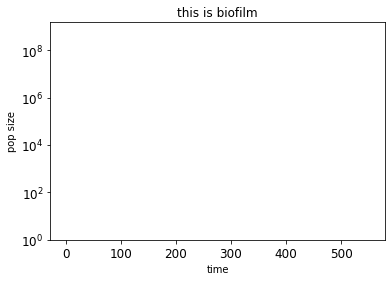

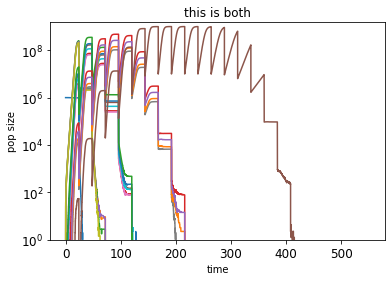

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
[[1.00000e+06 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [9.99957e+05 2.00000e+00 6.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [9.99582e+05 4.00000e+00 1.00000e+01 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 ...
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]]
plotting results, only pla should be present


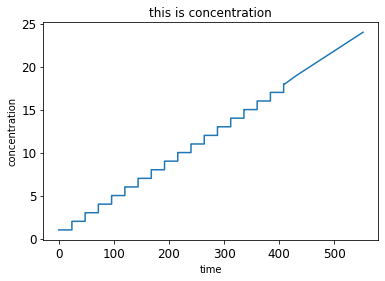

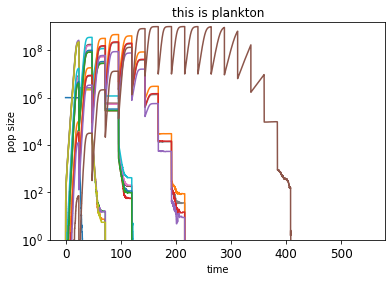

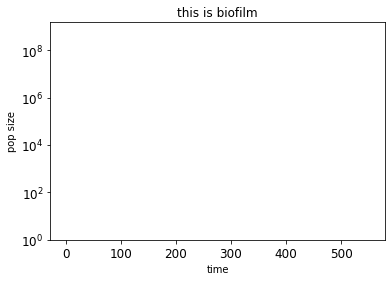

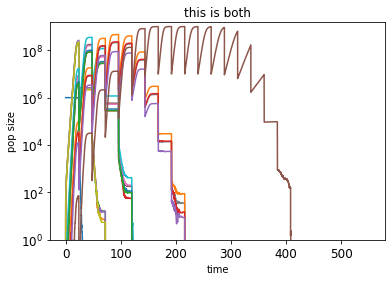

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
[[1.000000e+06 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [1.000360e+06 2.000000e+00 2.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [1.000507e+06 4.000000e+00 4.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]]
plotting results, only pla should be present


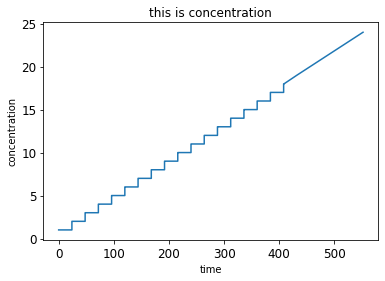

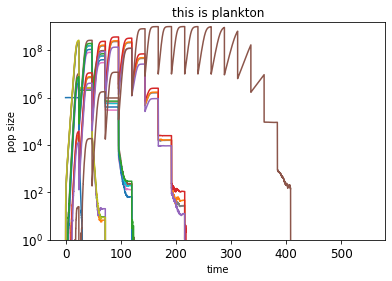

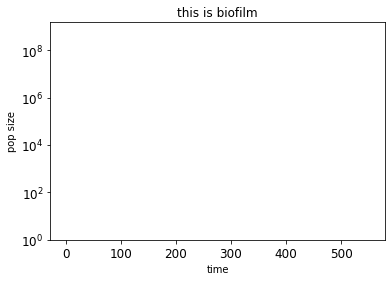

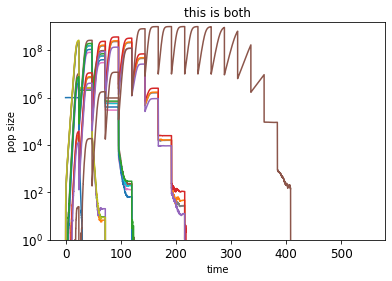

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
[[1.00000e+06 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [9.99963e+05 2.00000e+00 4.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [9.99847e+05 4.00000e+00 6.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 ...
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]]
plotting results, only pla should be present


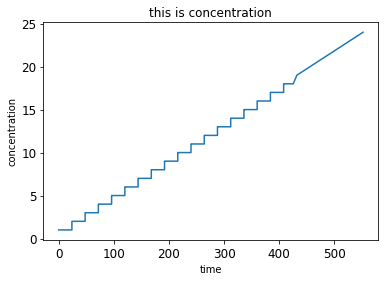

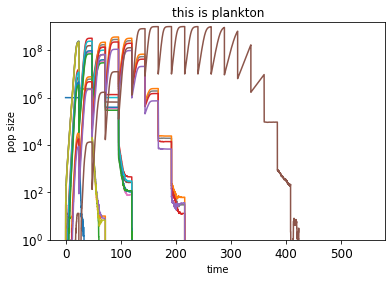

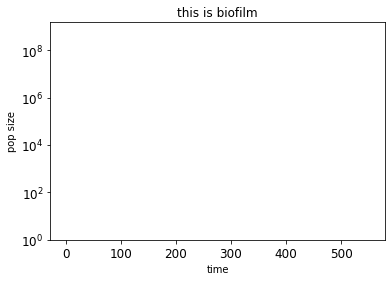

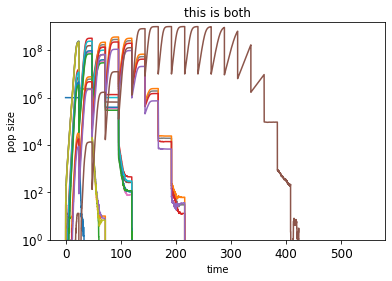

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
[[1.00000e+06 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [9.99697e+05 2.00000e+00 1.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [9.99562e+05 3.00000e+00 2.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 ...
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]]
plotting results, only pla should be present


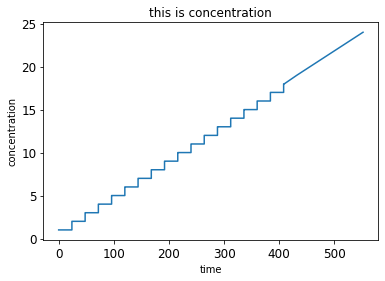

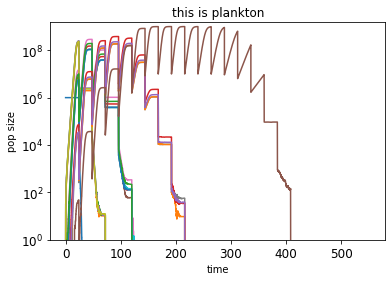

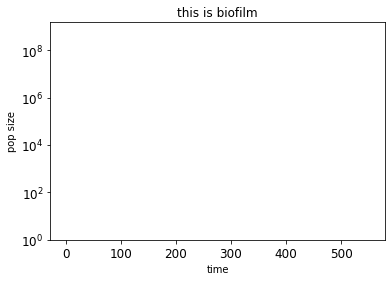

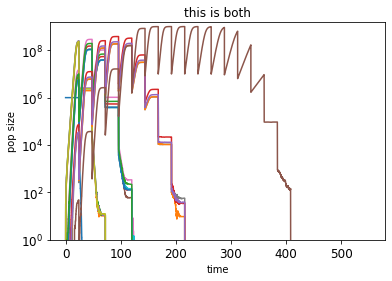

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
[[1.00000e+06 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [9.99888e+05 1.00000e+00 4.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [9.99959e+05 2.00000e+00 8.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 ...
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]
 [0.00000e+00 0.00000e+00 0.00000e+00 ... 0.00000e+00 0.00000e+00
  0.00000e+00]]
plotting results, only pla should be present


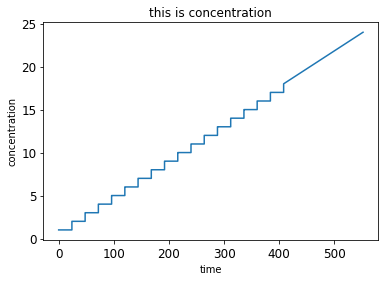

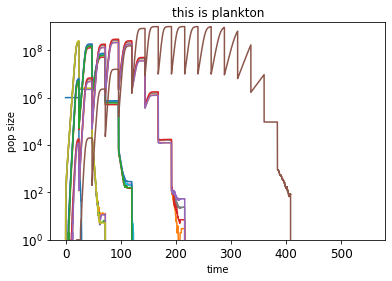

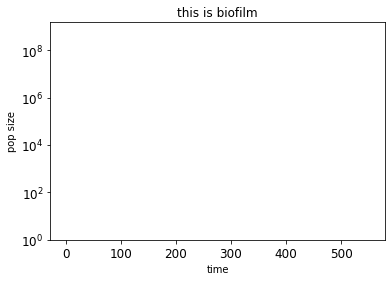

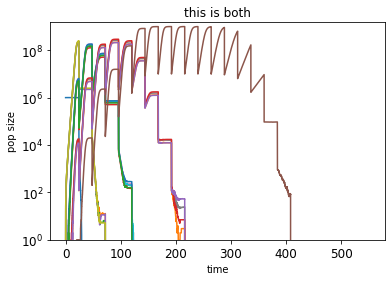

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
[[1.000000e+06 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [1.000443e+06 2.000000e+00 4.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [1.000508e+06 6.000000e+00 4.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]]
plotting results, only pla should be present


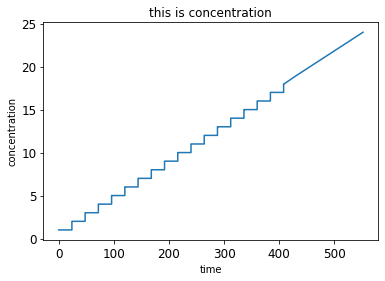

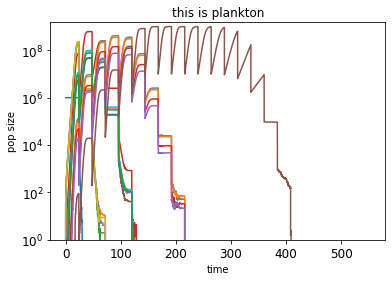

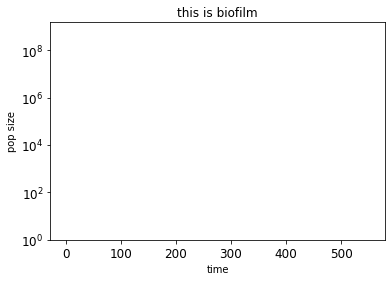

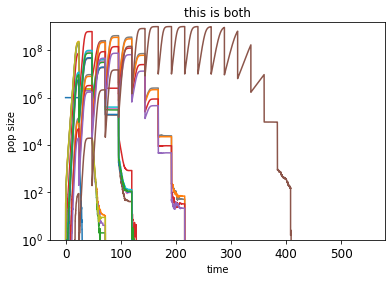

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
propensities are 0
[[1.000000e+06 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [1.000003e+06 8.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [1.000097e+06 1.100000e+01 2.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 0.000000e+00 ... 0.000000e+00 0.000000e+00
  0.000000e+00]]
plotting results, only pla should be present


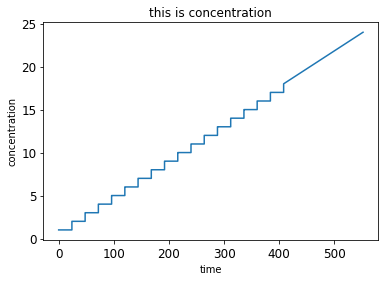

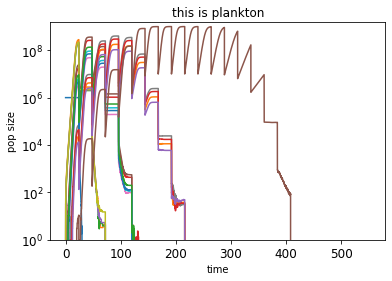

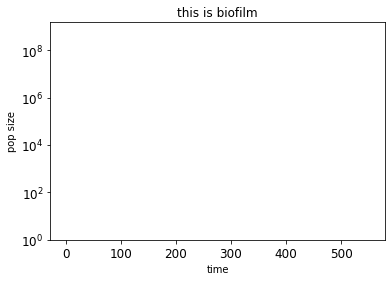

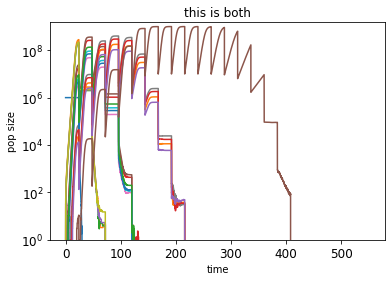

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
plotting results, only bio should be present


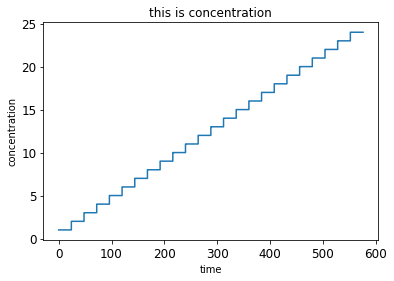

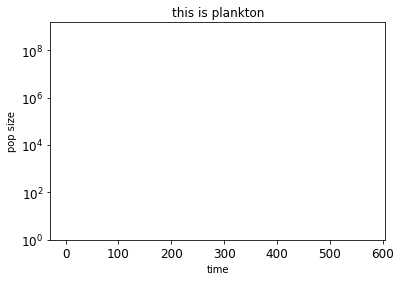

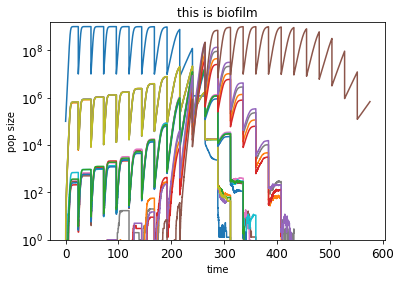

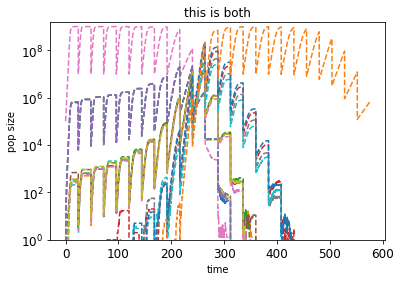

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
plotting results, only bio should be present


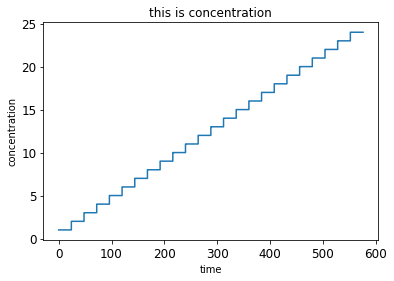

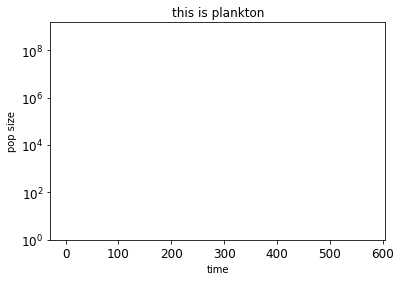

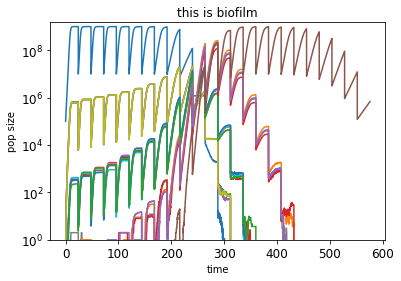

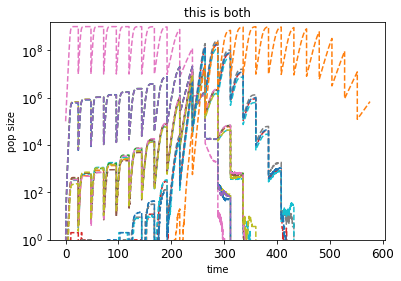

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
plotting results, only bio should be present


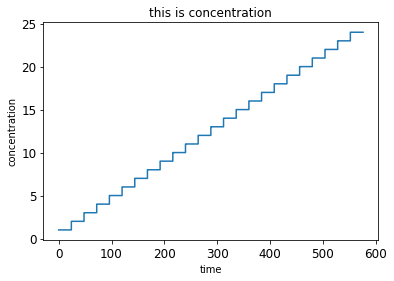

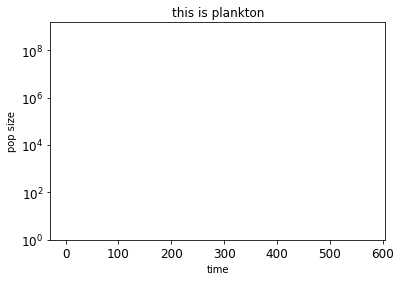

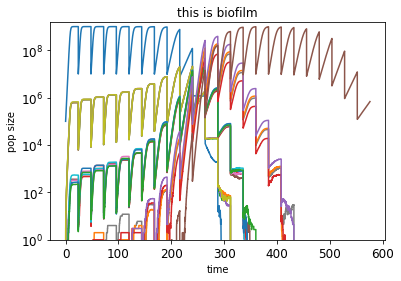

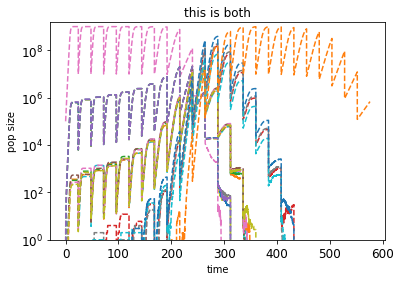

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
plotting results, only bio should be present


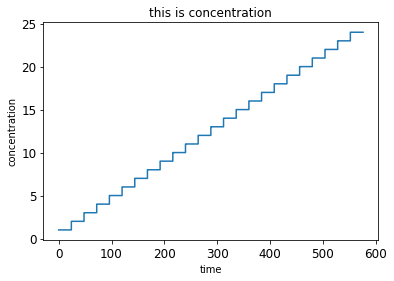

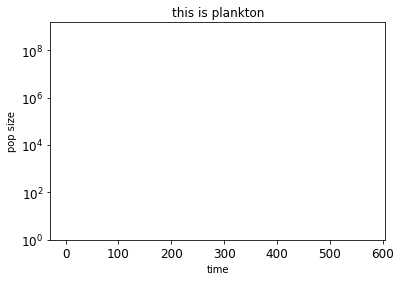

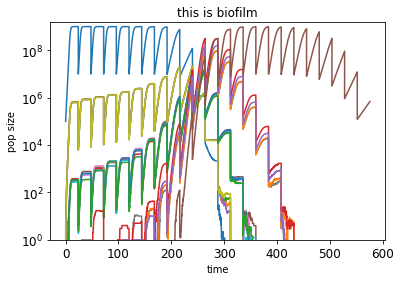

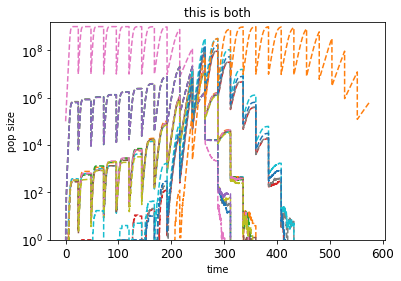

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
plotting results, only bio should be present


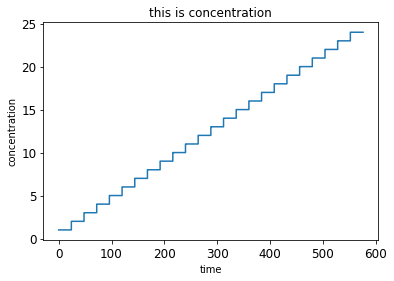

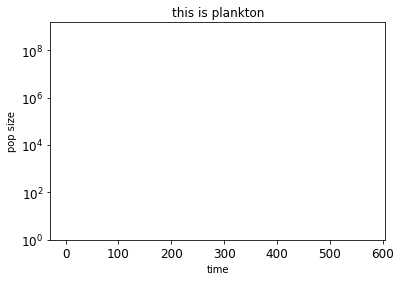

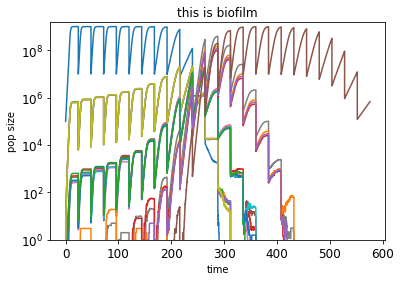

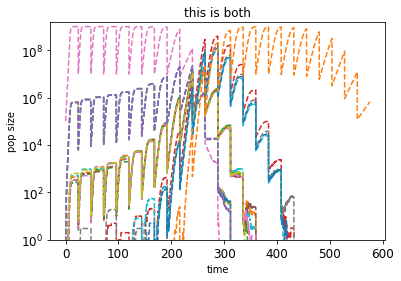

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
plotting results, only bio should be present


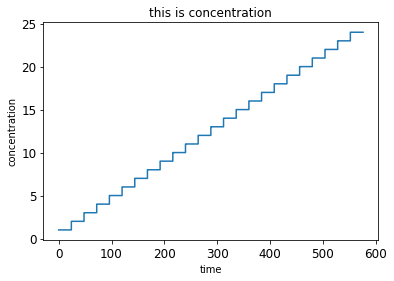

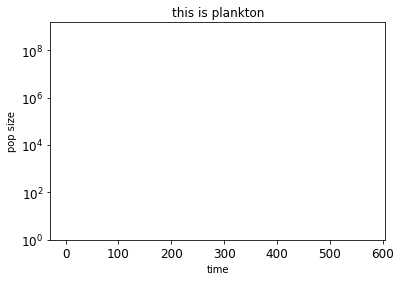

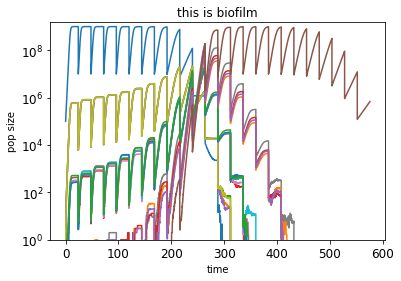

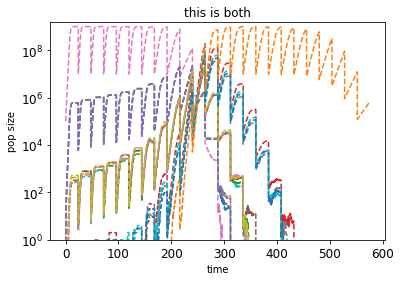

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
plotting results, only bio should be present


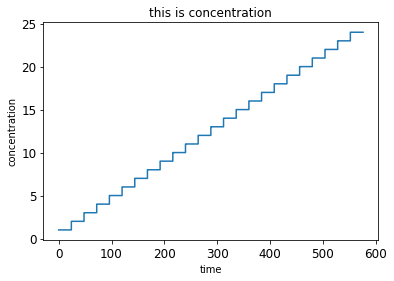

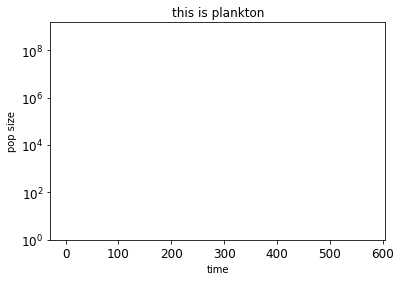

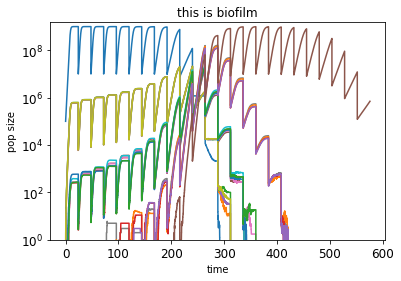

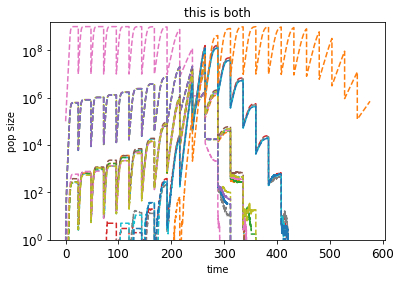

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
plotting results, only bio should be present


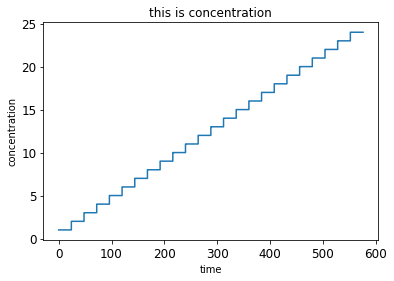

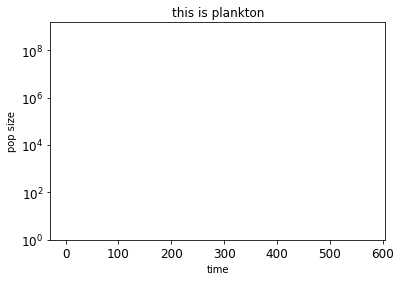

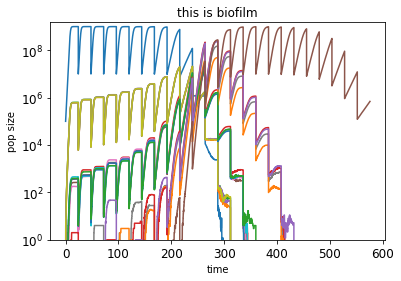

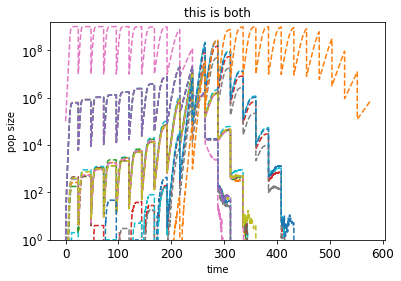

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
plotting results, only bio should be present


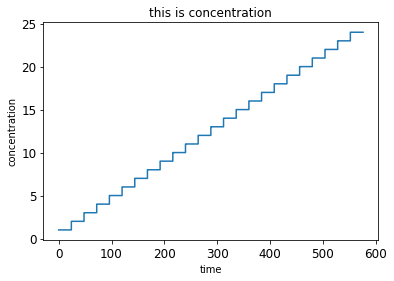

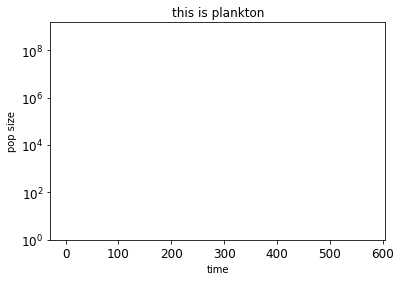

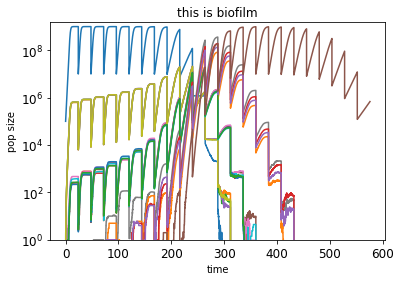

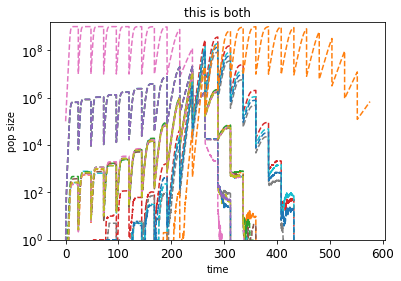

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
plotting results, only bio should be present


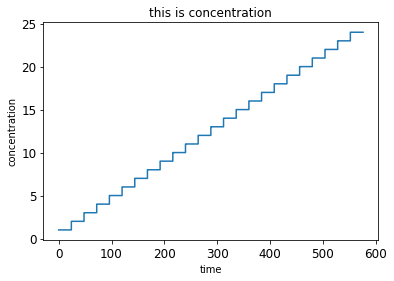

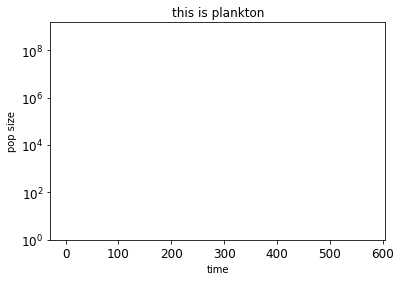

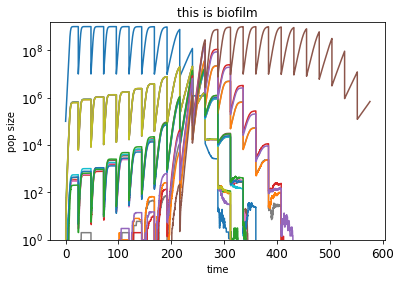

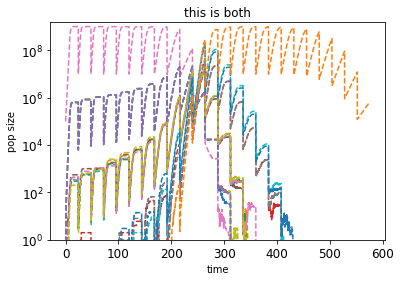

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
plotting results, only bio should be present


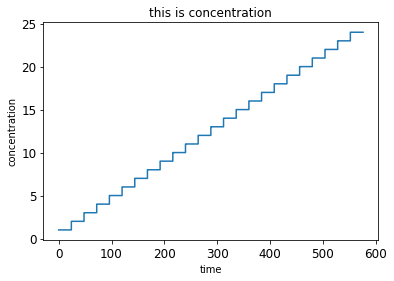

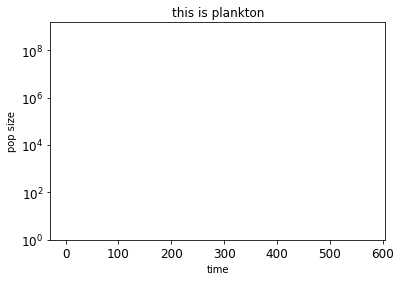

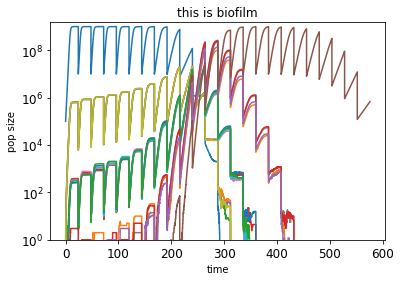

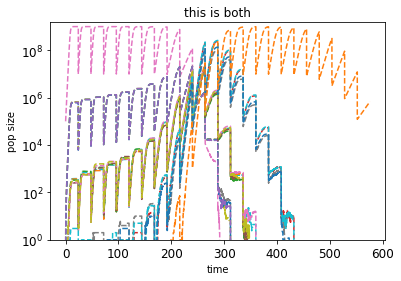

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
plotting results, only bio should be present


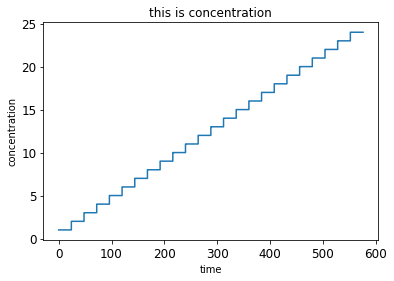

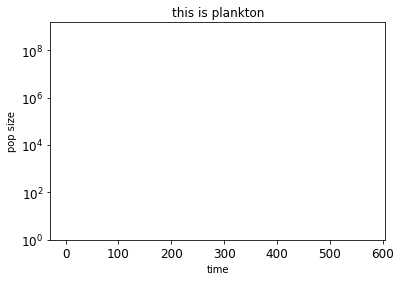

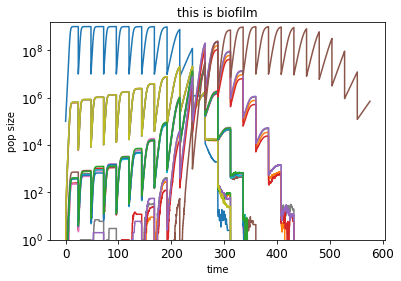

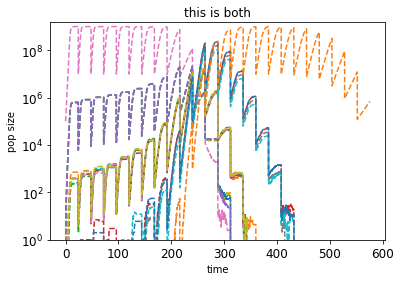

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
plotting results, only bio should be present


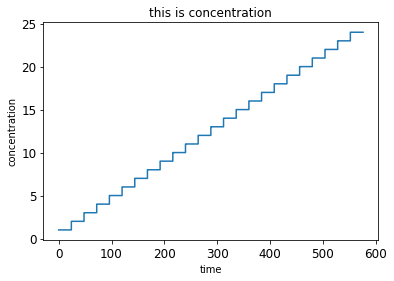

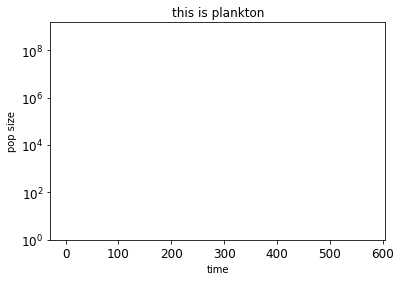

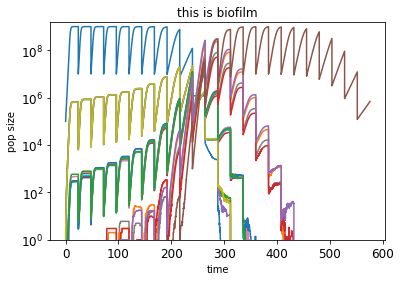

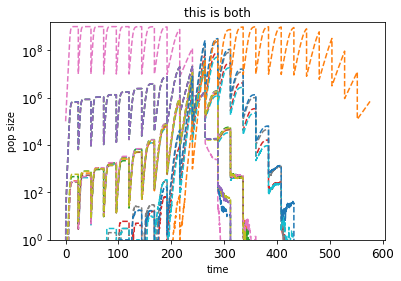

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
plotting results, only bio should be present


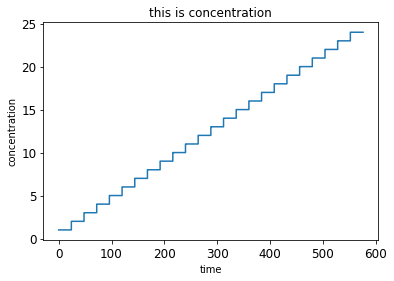

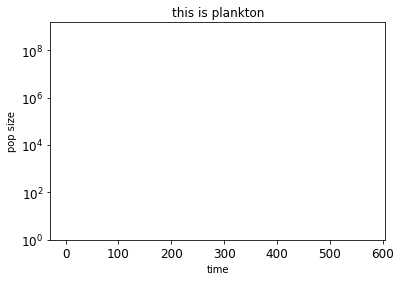

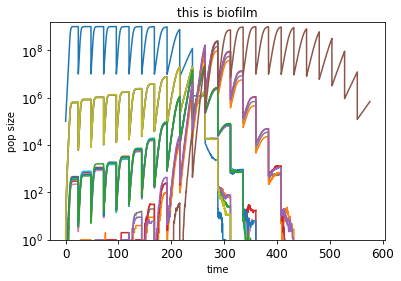

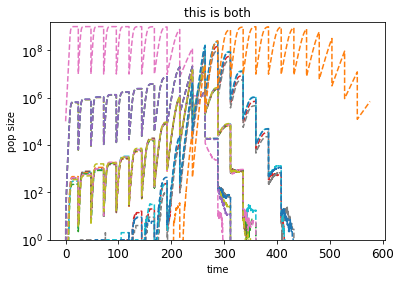

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
plotting results, only bio should be present


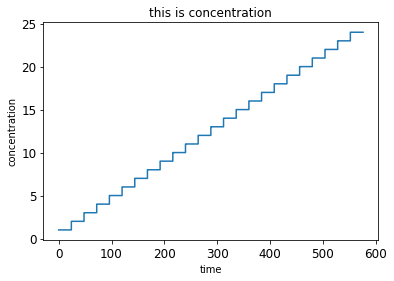

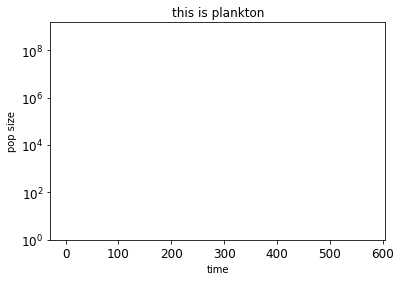

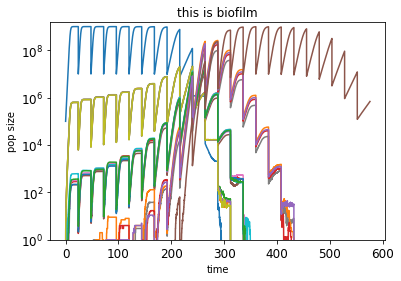

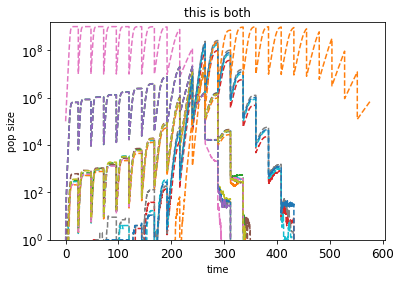

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
plotting results, only bio should be present


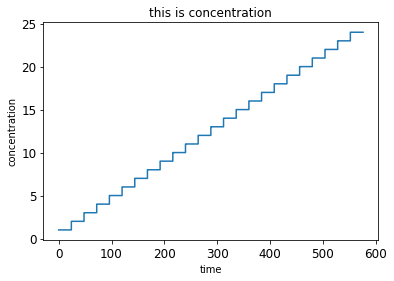

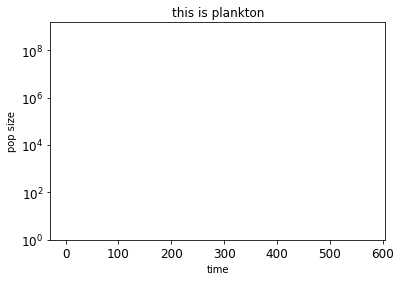

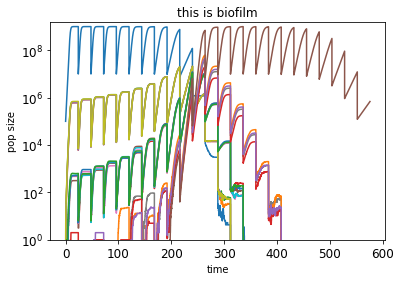

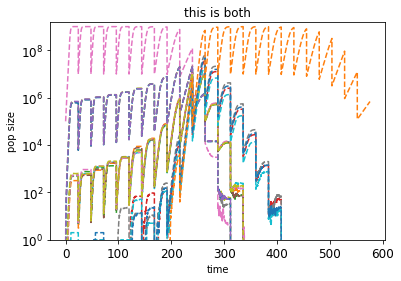

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
plotting results, only bio should be present


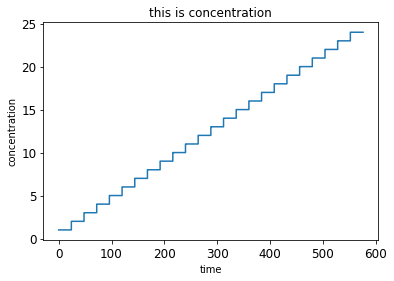

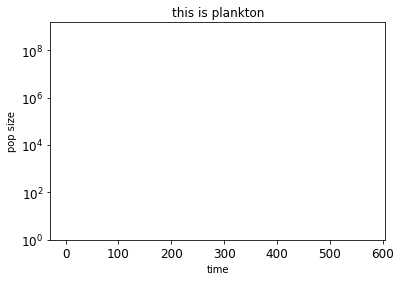

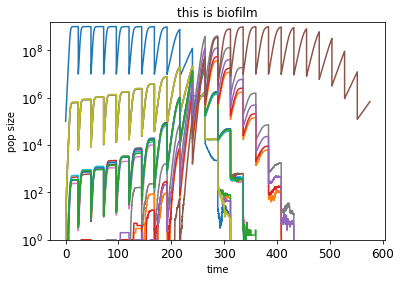

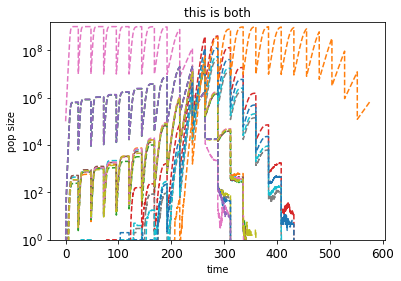

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
plotting results, only bio should be present


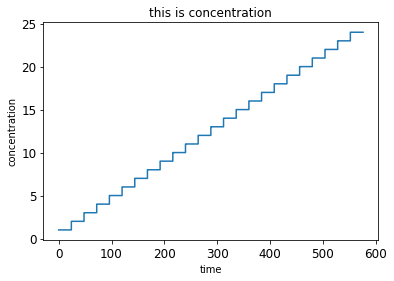

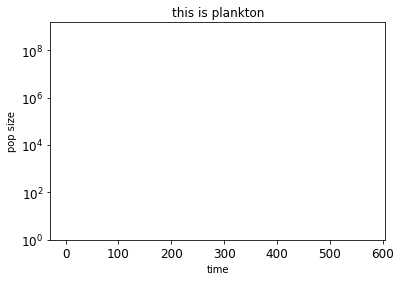

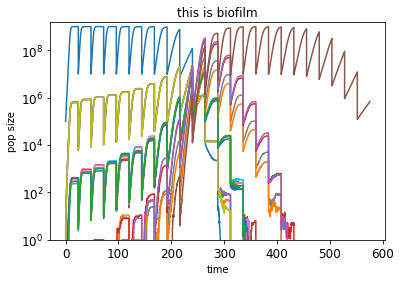

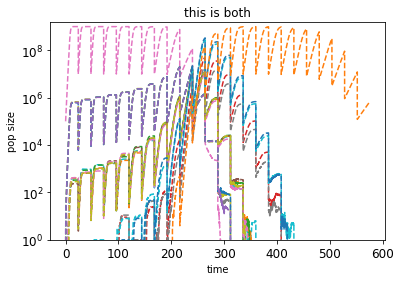

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
plotting results, only bio should be present


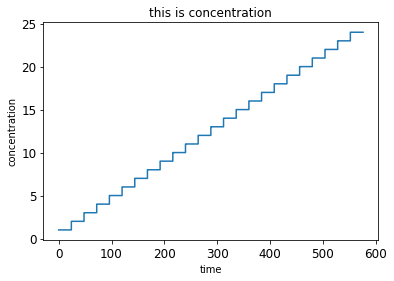

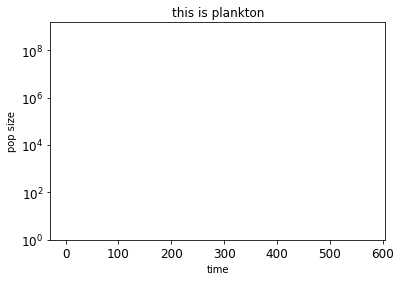

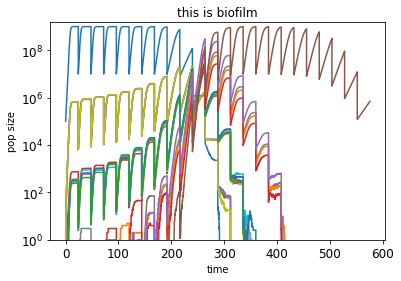

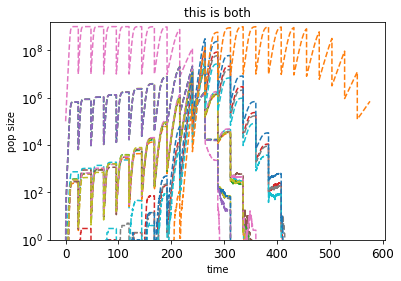

running stochastic simulation
initiated
[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
plotting results, only bio should be present


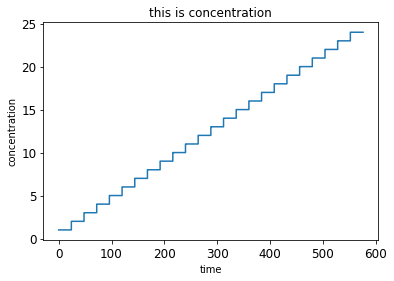

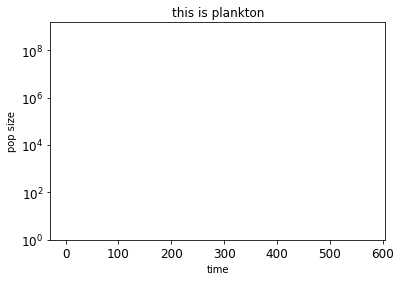

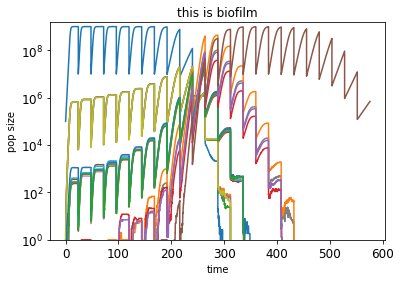

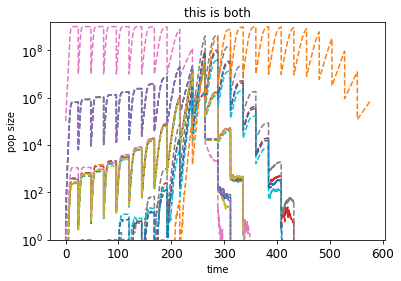

In [154]:
test=run_experiment_SlowDown(name='Facilitate', N=20)

In [39]:
plt.rcParams['axes.linewidth'] = 0.2 #set the value globally
plt.rc('lines', linewidth=1)
plt.rcParams['xtick.major.size'] = 2
plt.rcParams['xtick.major.width'] = 1
plt.rcParams['xtick.minor.size'] = 1
plt.rcParams['xtick.minor.width'] = 1
plt.rc('axes', titlesize=10)
plt.rcParams.update({'font.size': 15})

#plt.rcParams['legend.fonstsize'] = 1
plt.rc('xtick', labelsize=15) 
plt.rc('ytick', labelsize=15) 

plt.rcParams['font.size']=15
plt.rcParams.keys()
from cycler import cycler

analysis active


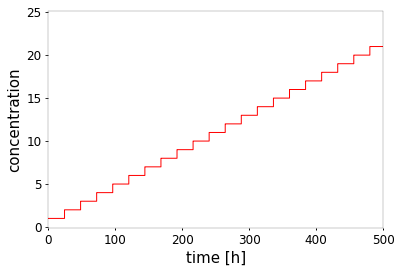

In [195]:
my_analysis=Analysis_functions(name='Facilitate',loci=4)
#my_analysis.plot_average_mutation_number(N=20) 
#my_analysis.plot_total_populations(N=20)
#my_analysis.get_composition(N=20)
my_analysis.plot_some_dynamics(N=20)


# Experiment 1
in this experiment, first only red mutant is present. It starts as plankton only, then biofilm is grown over time T_init

Every 24h, biofilm is kept, but the plankton is diluted 100 times. 

After T_init, plankton is fully removed and added a new one, collored in green. It is allowed to grow for 24h

We want to have a look at the a) ratio red/green in the plankton  b) ratio red/green in biofilm for various parameters - release rate, adhesion rate, growth rate of plankton, growth rate of biofilm (cost)





In [46]:
def run_experiment_1(cost,release_rate, adhesion_rate, T1=24, T2=24, name='experiment'):
    

    ####### GENERAL PROPERTIES OF THE POPULATION ########
    loci=1
    mutation_rate=0.000
    cost_vector=[cost]   #loc_costs = 0 * c_c * np.random.rand(k) + c_c
    benefit_vector=[0]  
    biofilm_benefit=5
    biofilm_cost=0.01
    psi_max_s=0.0231 
    psi_min=-0.0833
    gamma=0.00007
    MIC = 1.0

    #release_rate = 0.00000001
    #adhesion=0.00001

    init_pop=np.zeros(2**loci)
    car_cap=10**9
    
    ######### PROPERTIES OF THE EXPERIMENT, INCLUDING THE DRUG PARAMETERS #######
    #### non of this matters for the red and green experiement?
    kappa=1.5
    #cycle_length = 1 * 24 * 60  # length of a cycle in minutes
    init_conc = 0.0 * MIC  # intitial antibiotic concentration
    
    degradation_rate=-0.000004
    concentration_gradient=[0]
    cycle_number=len(concentration_gradient)
    
    
    ########## SPECIFICS OF THIS EXPERIMENT #####################################
    ############ Starting population initialization  ###############

    cycle_length=T1*60
    #Define planktonic population of only green color (allele 0)
    living_style=0
    init_pop=np.zeros(2**loci)
    init_pop[0]=1000000  #this defines green population
    my_pla_population=Bacterial_population(init_pop,loci=loci,psi_max_s=psi_max_s, psi_min=psi_min, gamma=gamma, MIC = MIC, cost_vector=cost_vector,benefit_vector=benefit_vector, mutation_rate=mutation_rate, living_style=living_style, biofilm_benefit=biofilm_benefit, biofilm_cost=biofilm_cost, release_rate=release_rate, adhesion=adhesion)

    # Define Biofilm population - it is empty

    living_style=1
    init_pop=np.zeros(2**loci)
    my_bio_population=Bacterial_population(init_pop,loci=loci,psi_max_s=psi_max_s, psi_min=psi_min, gamma=gamma, MIC = MIC, cost_vector=cost_vector,benefit_vector=benefit_vector, mutation_rate=mutation_rate, living_style=living_style, biofilm_benefit=biofilm_benefit, biofilm_cost=biofilm_cost, release_rate=release_rate, adhesion=adhesion)
    
    #Run this for two days to form biofilm
    first_treatment=Treatment(concentration_gradient, cycle_length=cycle_length , cycle_number=cycle_number, car_cap=car_cap,kappa=kappa, degradation_rate=degradation_rate)
    first_treatment.run_deterministic_simulation(my_pla_population, my_bio_population)
    #first_treatment.plot_results()
    
    #print ('pops after t1',(first_treatment.final_populations))
    
    ############ Switching to another color  ###############
    
    cycle_length=T2*60
    #Remove green plankton (allele 0), add red plankton
    
    
    living_style=0
    init_pop=np.zeros(2**loci)
    init_pop[1]=1000000     #this defines red population
    second_pla_population=Bacterial_population(init_pop,loci=loci,psi_max_s=psi_max_s, psi_min=psi_min, gamma=gamma, MIC = MIC, cost_vector=cost_vector,benefit_vector=benefit_vector, mutation_rate=mutation_rate, living_style=living_style, biofilm_benefit=biofilm_benefit, biofilm_cost=biofilm_cost, release_rate=release_rate, adhesion=adhesion)

    
    living_style=1
    init_pop=np.zeros(2**loci)
    init_pop[0]=first_treatment.final_populations[2]     #this should be green population of biofilm
    second_bio_population=Bacterial_population(init_pop,loci=loci,psi_max_s=psi_max_s, psi_min=psi_min, gamma=gamma, MIC = MIC, cost_vector=cost_vector,benefit_vector=benefit_vector, mutation_rate=mutation_rate, living_style=living_style, biofilm_benefit=biofilm_benefit, biofilm_cost=biofilm_cost, release_rate=release_rate, adhesion=adhesion)

    concentration_gradient=[0]
    cycle_number=len(concentration_gradient)
    second_treatment=Treatment(concentration_gradient, cycle_length=cycle_length , cycle_number=cycle_number, car_cap=car_cap,kappa=kappa, degradation_rate=degradation_rate)
    second_treatment.run_deterministic_simulation(second_pla_population, second_bio_population)
    #second_treatment.plot_results()
    #RG_ratio=[second_treatment.final_populations[1]/second_treatment.final_populations[0], second_treatment.final_populations[3]/second_treatment.final_populations[2]]
    complete_pla_dynamics=np.concatenate((first_treatment.pla_population_record,second_treatment.pla_population_record))
    complete_bio_dynamics=np.concatenate((first_treatment.bio_population_record,second_treatment.bio_population_record))
    complete_dynamics=np.concatenate((complete_pla_dynamics, complete_bio_dynamics), axis=1)
    
    #plt.semilogy(complete_dynamics)
    #plt.legend(['pla g', 'pla r', 'bio g', 'bio r'])
    #plt.show()
     
    np.save(name,complete_dynamics)
    
    return (second_treatment.final_populations)

In [374]:
cost=0.2
release=0.00000001
adhesion=0.00000001
T1=24
T2=96-T1
test=run_experiment_1(cost,release, adhesion, T1=T1, T2=T2, name='test')
testR=np.load('test.npy')
testR=np.log10(testR)
plt.plot(testR)
#plt.semilogy(testR)
plt.legend(['pla g', 'pla r', 'bio g', 'bio r'])
plt.show()


cost=0.2
release=0.1
adhesion=0.1
T1=24
T2=96-T1
test=run_experiment_1(cost,release, adhesion, T1=T1, T2=T2, name='test')
testR=np.load('test.npy')
testR=np.log10(testR)
plt.plot(testR)
#plt.semilogy(testR)
plt.legend(['pla g', 'pla r', 'bio g', 'bio r'])
plt.show()


TypeError: __init__() got an unexpected keyword argument 'adhesion'

In [5]:
def Scan_parameters():
    cost_range=np.linspace(0,1,21)
    release_range = [0.00000001, 0.0000001,0.000001,0.00001,0.0001,0.001,0.01, 0.1]
    adhesion_range=[0.00000001, 0.0000001,0.000001,0.00001,0.0001,0.001,0.01,0.1]
    T1_range=[12,24,48,96]
    result_recorder=np.zeros([len(cost_range)*len(release_range)*len(adhesion_range)*len(T1_range), 4])
    input_recorder=np.zeros([len(cost_range)*len(release_range)*len(adhesion_range)*len(T1_range), 4])
    counter=0
    for i in range (len(cost_range)):
        cost=cost_range[i]
        for j in range (len(release_range)):
            release=release_range[j]
            for k in range (len(adhesion_range)):
                adhesion=adhesion_range[k]
                for l in range (len(T1_range)):
                    T1=T1_range[l]
                    T2=96-T1
                    name='E2_C'+str(cost)+'Rho'+str(release)+'Alpha'+str(adhesion)+'T1'+str(T1)
                    
                    print ('running cycle:', counter)
                    #print ('parameters:',cost, release, adhesion, T1, T2 )
                    #print ('name', name)

                    results=run_experiment_1(cost,release, adhesion, T1=T1, T2=T2, name=name)
                    result_recorder[counter,:]=results
                    input_recorder[counter,:]=[cost, release, adhesion, T1]
                    
                    counter=counter+1
    return [input_recorder, result_recorder]
                    
[inputs, results]=Scan_parameters()  

running cycle: 0
running cycle: 1
running cycle: 2
running cycle: 3
running cycle: 4
running cycle: 5
running cycle: 6
running cycle: 7
running cycle: 8
running cycle: 9
running cycle: 10
running cycle: 11
running cycle: 12
running cycle: 13
running cycle: 14
running cycle: 15
running cycle: 16
running cycle: 17
running cycle: 18
running cycle: 19
running cycle: 20
running cycle: 21
running cycle: 22
running cycle: 23
running cycle: 24
running cycle: 25
running cycle: 26
running cycle: 27
running cycle: 28
running cycle: 29
running cycle: 30
running cycle: 31
running cycle: 32
running cycle: 33
running cycle: 34
running cycle: 35
running cycle: 36
running cycle: 37
running cycle: 38
running cycle: 39
running cycle: 40
running cycle: 41
running cycle: 42
running cycle: 43
running cycle: 44
running cycle: 45
running cycle: 46
running cycle: 47
running cycle: 48
running cycle: 49
running cycle: 50
running cycle: 51
running cycle: 52
running cycle: 53
running cycle: 54
running cycle: 55
ru

running cycle: 439
running cycle: 440
running cycle: 441
running cycle: 442
running cycle: 443
running cycle: 444
running cycle: 445
running cycle: 446
running cycle: 447
running cycle: 448
running cycle: 449
running cycle: 450
running cycle: 451
running cycle: 452
running cycle: 453
running cycle: 454
running cycle: 455
running cycle: 456
running cycle: 457
running cycle: 458
running cycle: 459
running cycle: 460
running cycle: 461
running cycle: 462
running cycle: 463
running cycle: 464
running cycle: 465
running cycle: 466
running cycle: 467
running cycle: 468
running cycle: 469
running cycle: 470
running cycle: 471
running cycle: 472
running cycle: 473
running cycle: 474
running cycle: 475
running cycle: 476
running cycle: 477
running cycle: 478
running cycle: 479
running cycle: 480
running cycle: 481
running cycle: 482
running cycle: 483
running cycle: 484
running cycle: 485
running cycle: 486
running cycle: 487
running cycle: 488
running cycle: 489
running cycle: 490
running cycl

running cycle: 874
running cycle: 875
running cycle: 876
running cycle: 877
running cycle: 878
running cycle: 879
running cycle: 880
running cycle: 881
running cycle: 882
running cycle: 883
running cycle: 884
running cycle: 885
running cycle: 886
running cycle: 887
running cycle: 888
running cycle: 889
running cycle: 890
running cycle: 891
running cycle: 892
running cycle: 893
running cycle: 894
running cycle: 895
running cycle: 896
running cycle: 897
running cycle: 898
running cycle: 899
running cycle: 900
running cycle: 901
running cycle: 902
running cycle: 903
running cycle: 904
running cycle: 905
running cycle: 906
running cycle: 907
running cycle: 908
running cycle: 909
running cycle: 910
running cycle: 911
running cycle: 912
running cycle: 913
running cycle: 914
running cycle: 915
running cycle: 916
running cycle: 917
running cycle: 918
running cycle: 919
running cycle: 920
running cycle: 921
running cycle: 922
running cycle: 923
running cycle: 924
running cycle: 925
running cycl

running cycle: 1293
running cycle: 1294
running cycle: 1295
running cycle: 1296
running cycle: 1297
running cycle: 1298
running cycle: 1299
running cycle: 1300
running cycle: 1301
running cycle: 1302
running cycle: 1303
running cycle: 1304
running cycle: 1305
running cycle: 1306
running cycle: 1307
running cycle: 1308
running cycle: 1309
running cycle: 1310
running cycle: 1311
running cycle: 1312
running cycle: 1313
running cycle: 1314
running cycle: 1315
running cycle: 1316
running cycle: 1317
running cycle: 1318
running cycle: 1319
running cycle: 1320
running cycle: 1321
running cycle: 1322
running cycle: 1323
running cycle: 1324
running cycle: 1325
running cycle: 1326
running cycle: 1327
running cycle: 1328
running cycle: 1329
running cycle: 1330
running cycle: 1331
running cycle: 1332
running cycle: 1333
running cycle: 1334
running cycle: 1335
running cycle: 1336
running cycle: 1337
running cycle: 1338
running cycle: 1339
running cycle: 1340
running cycle: 1341
running cycle: 1342


running cycle: 1703
running cycle: 1704
running cycle: 1705
running cycle: 1706
running cycle: 1707
running cycle: 1708
running cycle: 1709
running cycle: 1710
running cycle: 1711
running cycle: 1712
running cycle: 1713
running cycle: 1714
running cycle: 1715
running cycle: 1716
running cycle: 1717
running cycle: 1718
running cycle: 1719
running cycle: 1720
running cycle: 1721
running cycle: 1722
running cycle: 1723
running cycle: 1724
running cycle: 1725
running cycle: 1726
running cycle: 1727
running cycle: 1728
running cycle: 1729
running cycle: 1730
running cycle: 1731
running cycle: 1732
running cycle: 1733
running cycle: 1734
running cycle: 1735
running cycle: 1736
running cycle: 1737
running cycle: 1738
running cycle: 1739
running cycle: 1740
running cycle: 1741
running cycle: 1742
running cycle: 1743
running cycle: 1744
running cycle: 1745
running cycle: 1746
running cycle: 1747
running cycle: 1748
running cycle: 1749
running cycle: 1750
running cycle: 1751
running cycle: 1752


running cycle: 2115
running cycle: 2116
running cycle: 2117
running cycle: 2118
running cycle: 2119
running cycle: 2120
running cycle: 2121
running cycle: 2122
running cycle: 2123
running cycle: 2124
running cycle: 2125
running cycle: 2126
running cycle: 2127
running cycle: 2128
running cycle: 2129
running cycle: 2130
running cycle: 2131
running cycle: 2132
running cycle: 2133
running cycle: 2134
running cycle: 2135
running cycle: 2136
running cycle: 2137
running cycle: 2138
running cycle: 2139
running cycle: 2140
running cycle: 2141
running cycle: 2142
running cycle: 2143
running cycle: 2144
running cycle: 2145
running cycle: 2146
running cycle: 2147
running cycle: 2148
running cycle: 2149
running cycle: 2150
running cycle: 2151
running cycle: 2152
running cycle: 2153
running cycle: 2154
running cycle: 2155
running cycle: 2156
running cycle: 2157
running cycle: 2158
running cycle: 2159
running cycle: 2160
running cycle: 2161
running cycle: 2162
running cycle: 2163
running cycle: 2164


running cycle: 2525
running cycle: 2526
running cycle: 2527
running cycle: 2528
running cycle: 2529
running cycle: 2530
running cycle: 2531
running cycle: 2532
running cycle: 2533
running cycle: 2534
running cycle: 2535
running cycle: 2536
running cycle: 2537
running cycle: 2538
running cycle: 2539
running cycle: 2540
running cycle: 2541
running cycle: 2542
running cycle: 2543
running cycle: 2544
running cycle: 2545
running cycle: 2546
running cycle: 2547
running cycle: 2548
running cycle: 2549
running cycle: 2550
running cycle: 2551
running cycle: 2552
running cycle: 2553
running cycle: 2554
running cycle: 2555
running cycle: 2556
running cycle: 2557
running cycle: 2558
running cycle: 2559
running cycle: 2560
running cycle: 2561
running cycle: 2562
running cycle: 2563
running cycle: 2564
running cycle: 2565
running cycle: 2566
running cycle: 2567
running cycle: 2568
running cycle: 2569
running cycle: 2570
running cycle: 2571
running cycle: 2572
running cycle: 2573
running cycle: 2574


running cycle: 2938
running cycle: 2939
running cycle: 2940
running cycle: 2941
running cycle: 2942
running cycle: 2943
running cycle: 2944
running cycle: 2945
running cycle: 2946
running cycle: 2947
running cycle: 2948
running cycle: 2949
running cycle: 2950
running cycle: 2951
running cycle: 2952
running cycle: 2953
running cycle: 2954
running cycle: 2955
running cycle: 2956
running cycle: 2957
running cycle: 2958
running cycle: 2959
running cycle: 2960
running cycle: 2961
running cycle: 2962
running cycle: 2963
running cycle: 2964
running cycle: 2965
running cycle: 2966
running cycle: 2967
running cycle: 2968
running cycle: 2969
running cycle: 2970
running cycle: 2971
running cycle: 2972
running cycle: 2973
running cycle: 2974
running cycle: 2975
running cycle: 2976
running cycle: 2977
running cycle: 2978
running cycle: 2979
running cycle: 2980
running cycle: 2981
running cycle: 2982
running cycle: 2983
running cycle: 2984
running cycle: 2985
running cycle: 2986
running cycle: 2987


running cycle: 3350
running cycle: 3351
running cycle: 3352
running cycle: 3353
running cycle: 3354
running cycle: 3355
running cycle: 3356
running cycle: 3357
running cycle: 3358
running cycle: 3359
running cycle: 3360
running cycle: 3361
running cycle: 3362
running cycle: 3363
running cycle: 3364
running cycle: 3365
running cycle: 3366
running cycle: 3367
running cycle: 3368
running cycle: 3369
running cycle: 3370
running cycle: 3371
running cycle: 3372
running cycle: 3373
running cycle: 3374
running cycle: 3375
running cycle: 3376
running cycle: 3377
running cycle: 3378
running cycle: 3379
running cycle: 3380
running cycle: 3381
running cycle: 3382
running cycle: 3383
running cycle: 3384
running cycle: 3385
running cycle: 3386
running cycle: 3387
running cycle: 3388
running cycle: 3389
running cycle: 3390
running cycle: 3391
running cycle: 3392
running cycle: 3393
running cycle: 3394
running cycle: 3395
running cycle: 3396
running cycle: 3397
running cycle: 3398
running cycle: 3399


running cycle: 3762
running cycle: 3763
running cycle: 3764
running cycle: 3765
running cycle: 3766
running cycle: 3767
running cycle: 3768
running cycle: 3769
running cycle: 3770
running cycle: 3771
running cycle: 3772
running cycle: 3773
running cycle: 3774
running cycle: 3775
running cycle: 3776
running cycle: 3777
running cycle: 3778
running cycle: 3779
running cycle: 3780
running cycle: 3781
running cycle: 3782
running cycle: 3783
running cycle: 3784
running cycle: 3785
running cycle: 3786
running cycle: 3787
running cycle: 3788
running cycle: 3789
running cycle: 3790
running cycle: 3791
running cycle: 3792
running cycle: 3793
running cycle: 3794
running cycle: 3795
running cycle: 3796
running cycle: 3797
running cycle: 3798
running cycle: 3799
running cycle: 3800
running cycle: 3801
running cycle: 3802
running cycle: 3803
running cycle: 3804
running cycle: 3805
running cycle: 3806
running cycle: 3807
running cycle: 3808
running cycle: 3809
running cycle: 3810
running cycle: 3811


running cycle: 4174
running cycle: 4175
running cycle: 4176
running cycle: 4177
running cycle: 4178
running cycle: 4179
running cycle: 4180
running cycle: 4181
running cycle: 4182
running cycle: 4183
running cycle: 4184
running cycle: 4185
running cycle: 4186
running cycle: 4187
running cycle: 4188
running cycle: 4189
running cycle: 4190
running cycle: 4191
running cycle: 4192
running cycle: 4193
running cycle: 4194
running cycle: 4195
running cycle: 4196
running cycle: 4197
running cycle: 4198
running cycle: 4199
running cycle: 4200
running cycle: 4201
running cycle: 4202
running cycle: 4203
running cycle: 4204
running cycle: 4205
running cycle: 4206
running cycle: 4207
running cycle: 4208
running cycle: 4209
running cycle: 4210
running cycle: 4211
running cycle: 4212
running cycle: 4213
running cycle: 4214
running cycle: 4215
running cycle: 4216
running cycle: 4217
running cycle: 4218
running cycle: 4219
running cycle: 4220
running cycle: 4221
running cycle: 4222
running cycle: 4223


running cycle: 4584
running cycle: 4585
running cycle: 4586
running cycle: 4587
running cycle: 4588
running cycle: 4589
running cycle: 4590
running cycle: 4591
running cycle: 4592
running cycle: 4593
running cycle: 4594
running cycle: 4595
running cycle: 4596
running cycle: 4597
running cycle: 4598
running cycle: 4599
running cycle: 4600
running cycle: 4601
running cycle: 4602
running cycle: 4603
running cycle: 4604
running cycle: 4605
running cycle: 4606
running cycle: 4607
running cycle: 4608
running cycle: 4609
running cycle: 4610
running cycle: 4611
running cycle: 4612
running cycle: 4613
running cycle: 4614
running cycle: 4615
running cycle: 4616
running cycle: 4617
running cycle: 4618
running cycle: 4619
running cycle: 4620
running cycle: 4621
running cycle: 4622
running cycle: 4623
running cycle: 4624
running cycle: 4625
running cycle: 4626
running cycle: 4627
running cycle: 4628
running cycle: 4629
running cycle: 4630
running cycle: 4631
running cycle: 4632
running cycle: 4633


running cycle: 4995
running cycle: 4996
running cycle: 4997
running cycle: 4998
running cycle: 4999
running cycle: 5000
running cycle: 5001
running cycle: 5002
running cycle: 5003
running cycle: 5004
running cycle: 5005
running cycle: 5006
running cycle: 5007
running cycle: 5008
running cycle: 5009
running cycle: 5010
running cycle: 5011
running cycle: 5012
running cycle: 5013
running cycle: 5014
running cycle: 5015
running cycle: 5016
running cycle: 5017
running cycle: 5018
running cycle: 5019
running cycle: 5020
running cycle: 5021
running cycle: 5022
running cycle: 5023
running cycle: 5024
running cycle: 5025
running cycle: 5026
running cycle: 5027
running cycle: 5028
running cycle: 5029
running cycle: 5030
running cycle: 5031
running cycle: 5032
running cycle: 5033
running cycle: 5034
running cycle: 5035
running cycle: 5036
running cycle: 5037
running cycle: 5038
running cycle: 5039
running cycle: 5040
running cycle: 5041
running cycle: 5042
running cycle: 5043
running cycle: 5044


/Users/barbora/miniconda3/lib/python3.8/site-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


running cycle: 5311
running cycle: 5312
running cycle: 5313
running cycle: 5314
running cycle: 5315
running cycle: 5316
running cycle: 5317
running cycle: 5318
running cycle: 5319
running cycle: 5320
running cycle: 5321
running cycle: 5322
running cycle: 5323
running cycle: 5324
running cycle: 5325
running cycle: 5326
running cycle: 5327
running cycle: 5328
running cycle: 5329
running cycle: 5330
running cycle: 5331
running cycle: 5332
running cycle: 5333
running cycle: 5334
running cycle: 5335
running cycle: 5336
running cycle: 5337
running cycle: 5338
running cycle: 5339
running cycle: 5340
running cycle: 5341
running cycle: 5342
running cycle: 5343
running cycle: 5344
running cycle: 5345
running cycle: 5346
running cycle: 5347
running cycle: 5348
running cycle: 5349
running cycle: 5350
running cycle: 5351
running cycle: 5352
running cycle: 5353
running cycle: 5354
running cycle: 5355
running cycle: 5356
running cycle: 5357
running cycle: 5358
running cycle: 5359
running cycle: 5360


In [6]:
np.save('E2_inputs',inputs)
np.save('E2_results',results)


## THE END OF MAIN SIMULATIONS


## PLOTTING

In [ ]:
pip install ipympl

In [ ]:
## creating 3d bar plot using matplotlib
# in python

# to interacte with plot
import ipympl
from ipywidgets import *
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
%matplotlib widget

# importing required libraries
from mpl_toolkits.mplot3d import Axes3D

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
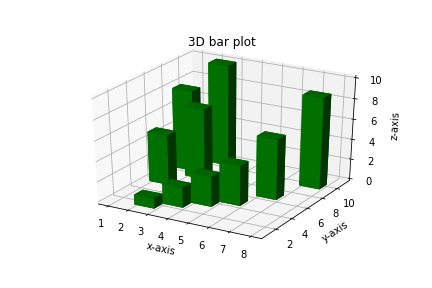

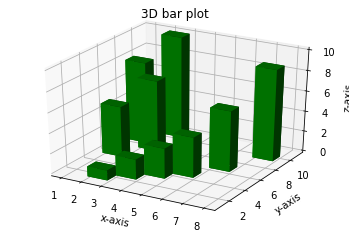

In [20]:
# creating random dataset
xs = [2, 3, 4, 5, 1, 6, 2, 1, 7, 2]
ys = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
zs = np.zeros(10)
dx = np.ones(10)
dy = np.ones(10)
dz = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]

# creating figure
figg = plt.figure()
ax = figg.add_subplot(111, projection='3d')

# creating the plot
plot_geeks = ax.bar3d(xs, ys, zs, dx,
					dy, dz, color='green')

# setting title and labels
ax.set_title("3D bar plot")
ax.set_xlabel('x-axis')
ax.set_ylabel('y-axis')
ax.set_zlabel('z-axis')

# displaying the plot
plt.show()

In [21]:
def Get_right_subset(inputs, results, cost=0.5,T1=24):
    subset1=inputs[inputs[:,0]==cost]
    subset2=subset1[subset1[:,3]==T1]
    
    r_subset1=results[inputs[:,0]==cost]
    r_subset2=r_subset1[subset1[:,3]==T1]
    
    return(subset2, r_subset2)


subset2, r_subset2=Get_right_subset(inputs, results, cost=0.5,T1=24)

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
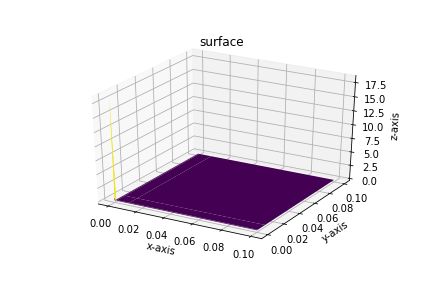

[[1.e-08 1.e-08 1.e-08 1.e-08 1.e-08 1.e-08 1.e-08 1.e-08]
 [1.e-07 1.e-07 1.e-07 1.e-07 1.e-07 1.e-07 1.e-07 1.e-07]
 [1.e-06 1.e-06 1.e-06 1.e-06 1.e-06 1.e-06 1.e-06 1.e-06]
 [1.e-05 1.e-05 1.e-05 1.e-05 1.e-05 1.e-05 1.e-05 1.e-05]
 [1.e-04 1.e-04 1.e-04 1.e-04 1.e-04 1.e-04 1.e-04 1.e-04]
 [1.e-03 1.e-03 1.e-03 1.e-03 1.e-03 1.e-03 1.e-03 1.e-03]
 [1.e-02 1.e-02 1.e-02 1.e-02 1.e-02 1.e-02 1.e-02 1.e-02]
 [1.e-01 1.e-01 1.e-01 1.e-01 1.e-01 1.e-01 1.e-01 1.e-01]] [[1.e-08 1.e-07 1.e-06 1.e-05 1.e-04 1.e-03 1.e-02 1.e-01]
 [1.e-08 1.e-07 1.e-06 1.e-05 1.e-04 1.e-03 1.e-02 1.e-01]
 [1.e-08 1.e-07 1.e-06 1.e-05 1.e-04 1.e-03 1.e-02 1.e-01]
 [1.e-08 1.e-07 1.e-06 1.e-05 1.e-04 1.e-03 1.e-02 1.e-01]
 [1.e-08 1.e-07 1.e-06 1.e-05 1.e-04 1.e-03 1.e-02 1.e-01]
 [1.e-08 1.e-07 1.e-06 1.e-05 1.e-04 1.e-03 1.e-02 1.e-01]
 [1.e-08 1.e-07 1.e-06 1.e-05 1.e-04 1.e-03 1.e-02 1.e-01]
 [1.e-08 1.e-07 1.e-06 1.e-05 1.e-04 1.e-03 1.e-02 1.e-01]] [[4.07788260e-09 4.08415155e-08 4.14752785e-07 4.85608

In [30]:
def Plot_3D_graph(inputs, results):
    X=inputs[:,1]
    Y=inputs[:,2]
    Z=results[:,1]
    X=np.reshape(X, [8,8])
    Y=np.reshape(Y, [8,8])
    Z=np.reshape(Z, [8,8])
    
    
    figg = plt.figure()
    ax = figg.add_subplot(111, projection='3d')

    # creating the plot
    #ax = plt.axes(projection='3d')
    ax.plot_surface(X, Y, Z, rstride=1, cstride=1,
                cmap='viridis', edgecolor='none')
    ax.set_title('surface');

    # setting title and labels
    ax.set_xlabel('x-axis')
    ax.set_ylabel('y-axis')
    ax.set_zlabel('z-axis')

    # displaying the plot
    plt.show()
    
    print (X,Y,Z)
    
Plot_3D_graph(subset2, r_subset2)


In [22]:
print (subset2)

[[5.0e-01 1.0e-08 1.0e-08 2.4e+01]
 [5.0e-01 1.0e-08 1.0e-07 2.4e+01]
 [5.0e-01 1.0e-08 1.0e-06 2.4e+01]
 [5.0e-01 1.0e-08 1.0e-05 2.4e+01]
 [5.0e-01 1.0e-08 1.0e-04 2.4e+01]
 [5.0e-01 1.0e-08 1.0e-03 2.4e+01]
 [5.0e-01 1.0e-08 1.0e-02 2.4e+01]
 [5.0e-01 1.0e-08 1.0e-01 2.4e+01]
 [5.0e-01 1.0e-07 1.0e-08 2.4e+01]
 [5.0e-01 1.0e-07 1.0e-07 2.4e+01]
 [5.0e-01 1.0e-07 1.0e-06 2.4e+01]
 [5.0e-01 1.0e-07 1.0e-05 2.4e+01]
 [5.0e-01 1.0e-07 1.0e-04 2.4e+01]
 [5.0e-01 1.0e-07 1.0e-03 2.4e+01]
 [5.0e-01 1.0e-07 1.0e-02 2.4e+01]
 [5.0e-01 1.0e-07 1.0e-01 2.4e+01]
 [5.0e-01 1.0e-06 1.0e-08 2.4e+01]
 [5.0e-01 1.0e-06 1.0e-07 2.4e+01]
 [5.0e-01 1.0e-06 1.0e-06 2.4e+01]
 [5.0e-01 1.0e-06 1.0e-05 2.4e+01]
 [5.0e-01 1.0e-06 1.0e-04 2.4e+01]
 [5.0e-01 1.0e-06 1.0e-03 2.4e+01]
 [5.0e-01 1.0e-06 1.0e-02 2.4e+01]
 [5.0e-01 1.0e-06 1.0e-01 2.4e+01]
 [5.0e-01 1.0e-05 1.0e-08 2.4e+01]
 [5.0e-01 1.0e-05 1.0e-07 2.4e+01]
 [5.0e-01 1.0e-05 1.0e-06 2.4e+01]
 [5.0e-01 1.0e-05 1.0e-05 2.4e+01]
 [5.0e-01 1.0e-05 1.

24
(6480, 4)
(81, 4)


<ipython-input-261-7b4a4b86e7e0>:20: RuntimeWarning: divide by zero encountered in log10
  X_log10=np.log10(X)
<ipython-input-261-7b4a4b86e7e0>:21: RuntimeWarning: divide by zero encountered in log10
  Y_log10=np.log10(Y)


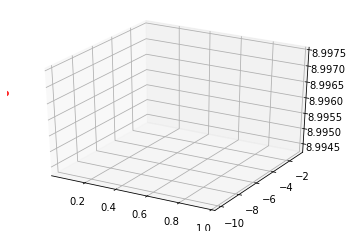

[-10. -10. -10. -10. -10. -10. -10. -10. -10.  -8.  -8.  -8.  -8.  -8.
  -8.  -8.  -8.  -8.  -7.  -7.  -7.  -7.  -7.  -7.  -7.  -7.  -7.  -6.
  -6.  -6.  -6.  -6.  -6.  -6.  -6.  -6.  -5.  -5.  -5.  -5.  -5.  -5.
  -5.  -5.  -5.  -4.  -4.  -4.  -4.  -4.  -4.  -4.  -4.  -4.  -3.  -3.
  -3.  -3.  -3.  -3.  -3.  -3.  -3.  -2.  -2.  -2.  -2.  -2.  -2.  -2.
  -2.  -2.  -1.  -1.  -1.  -1.  -1.  -1.  -1.  -1.  -1.]
[-10.  -8.  -7.  -6.  -5.  -4.  -3.  -2.  -1. -10.  -8.  -7.  -6.  -5.
  -4.  -3.  -2.  -1. -10.  -8.  -7.  -6.  -5.  -4.  -3.  -2.  -1. -10.
  -8.  -7.  -6.  -5.  -4.  -3.  -2.  -1. -10.  -8.  -7.  -6.  -5.  -4.
  -3.  -2.  -1. -10.  -8.  -7.  -6.  -5.  -4.  -3.  -2.  -1. -10.  -8.
  -7.  -6.  -5.  -4.  -3.  -2.  -1. -10.  -8.  -7.  -6.  -5.  -4.  -3.
  -2.  -1. -10.  -8.  -7.  -6.  -5.  -4.  -3.  -2.  -1.]
[8.9973599  8.99530021 8.99530023 8.9953005  8.99530318 8.99532622
 8.99539006 8.99519033 8.99443158 8.9973599  8.99530021 8.99530023
 8.9953005  8.99530318 8.99532622 8.995390

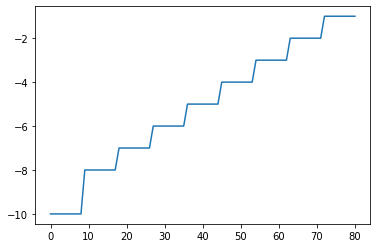

In [261]:
def MakePlots4D(inputs, results, cost=0.5,T1=24):
    # this function takes all the inputs and outputs and creates 3D figures for all outputs, for 2 inputs fixed and 2 inputs variable
    ## inputs = [cost, release, adhesion, T1]
    ## results =[plaG,plaR, bioG, bioR]
    print (T1)
    print (np.shape(inputs))
    subset1=inputs[inputs[:,0]==cost]
    subset2=subset1[subset1[:,3]==T1]
    print (np.shape(subset2))
    

    
    r_subset1=results[inputs[:,0]==cost]
    r_subset2=r_subset1[subset1[:,3]==T1]
    #print (r_subset2)
    
    X=subset2[:,1]
    Y=subset2[:,2]
    Z=r_subset2[:,1]
    X_log10=np.log10(X)
    Y_log10=np.log10(Y)
    X_log10[X_log10<-8]=-10
    Y_log10[Y_log10<-8]=-10
    Z_log10=np.log10(Z)

    for i in range (1):
        ax = plt.axes(projection='3d')
        #ax = plt.gca()
        #Z=r_subset2[:, i]
        #ax.scatter(X, Z)
        #ax.set_yscale('log')
        #ax.set_xscale('log')
        #ax.set_yscale('log')
        
        ax.scatter3D(X_log10, Y_log10, Z_log10, c='red', cmap='Greens');
        
        #ax = plt.axes(projection='3d')
        #ax.plot_surface(X, Y, Z, rstride=1, cstride=1,
        #        cmap='viridis', edgecolor='none')
        #ax.set_title('surface');
        #ax.xaxis.set_scale('log')
        #ax.yaxis.set_scale('log')
        plt.xlim(0.00000001, 1)
        plt.show()
    #print (X)
    print (X_log10) 
    print (Y_log10)
    print (Z_log10)
    #print (np.unique(X))
    
    plt.plot(X_log10)    
    #plt.plot(r_subset2)
    return (subset2, r_subset2)
[subset2, r_subset2]=MakePlots4D(inputs, results, cost=0,T1=24)

In [6]:
np.shape(subset2)
X=subset2[:,1]
Y=subset2[:,2]
Z=r_subset2[:,1]

print (X)
print (Y)
print (Z)
X=np.reshape(X, (9,9))
Y=np.reshape(Y, (9,9))
Z=np.reshape(Z, (9,9))

print (X)
print (Y)
print (Z)

ax = plt.axes(projection='3d')
ax.plot_surface(X, Y, Z, rstride=1, cstride=1,
                cmap='viridis', edgecolor='none') %qt
ax.set_title('surface');

NameError: name 'subset2' is not defined

In [258]:
x = [0,0.00000001, 0.0000001,0.000001,0.00001,0.0001,0.001,0.01, 0.1]
y=[0,0.00000001, 0.0000001,0.000001,0.00001,0.0001,0.001,0.01,0.1]
X, Y = np.meshgrid(x, y)
print (X)
print (Y)


[[0.e+00 1.e-08 1.e-07 1.e-06 1.e-05 1.e-04 1.e-03 1.e-02 1.e-01]
 [0.e+00 1.e-08 1.e-07 1.e-06 1.e-05 1.e-04 1.e-03 1.e-02 1.e-01]
 [0.e+00 1.e-08 1.e-07 1.e-06 1.e-05 1.e-04 1.e-03 1.e-02 1.e-01]
 [0.e+00 1.e-08 1.e-07 1.e-06 1.e-05 1.e-04 1.e-03 1.e-02 1.e-01]
 [0.e+00 1.e-08 1.e-07 1.e-06 1.e-05 1.e-04 1.e-03 1.e-02 1.e-01]
 [0.e+00 1.e-08 1.e-07 1.e-06 1.e-05 1.e-04 1.e-03 1.e-02 1.e-01]
 [0.e+00 1.e-08 1.e-07 1.e-06 1.e-05 1.e-04 1.e-03 1.e-02 1.e-01]
 [0.e+00 1.e-08 1.e-07 1.e-06 1.e-05 1.e-04 1.e-03 1.e-02 1.e-01]
 [0.e+00 1.e-08 1.e-07 1.e-06 1.e-05 1.e-04 1.e-03 1.e-02 1.e-01]]
[[0.e+00 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00]
 [1.e-08 1.e-08 1.e-08 1.e-08 1.e-08 1.e-08 1.e-08 1.e-08 1.e-08]
 [1.e-07 1.e-07 1.e-07 1.e-07 1.e-07 1.e-07 1.e-07 1.e-07 1.e-07]
 [1.e-06 1.e-06 1.e-06 1.e-06 1.e-06 1.e-06 1.e-06 1.e-06 1.e-06]
 [1.e-05 1.e-05 1.e-05 1.e-05 1.e-05 1.e-05 1.e-05 1.e-05 1.e-05]
 [1.e-04 1.e-04 1.e-04 1.e-04 1.e-04 1.e-04 1.e-04 1.e-04 1.e-04]
 [1.e-03 

In [250]:
def New_plots(inputs, results, T=24, cost=0):
    x = [0,0.00000001, 0.0000001,0.000001,0.00001,0.0001,0.001,0.01, 0.1]
    y=[0,0.00000001, 0.0000001,0.000001,0.00001,0.0001,0.001,0.01,0.1]
    X, Y = np.meshgrid(x, y)
    Z=0*X
    for i in inputs:
        print (i)
        if i[1]==
        

New_plots(inputs, results, T=24, cost=0)


[ 0.  0.  0. 12.]
[ 0.  0.  0. 24.]
[ 0.  0.  0. 48.]
[ 0.  0.  0. 96.]
[0.0e+00 0.0e+00 1.0e-08 1.2e+01]
[0.0e+00 0.0e+00 1.0e-08 2.4e+01]
[0.0e+00 0.0e+00 1.0e-08 4.8e+01]
[0.0e+00 0.0e+00 1.0e-08 9.6e+01]
[0.0e+00 0.0e+00 1.0e-07 1.2e+01]
[0.0e+00 0.0e+00 1.0e-07 2.4e+01]
[0.0e+00 0.0e+00 1.0e-07 4.8e+01]
[0.0e+00 0.0e+00 1.0e-07 9.6e+01]
[0.0e+00 0.0e+00 1.0e-06 1.2e+01]
[0.0e+00 0.0e+00 1.0e-06 2.4e+01]
[0.0e+00 0.0e+00 1.0e-06 4.8e+01]
[0.0e+00 0.0e+00 1.0e-06 9.6e+01]
[0.0e+00 0.0e+00 1.0e-05 1.2e+01]
[0.0e+00 0.0e+00 1.0e-05 2.4e+01]
[0.0e+00 0.0e+00 1.0e-05 4.8e+01]
[0.0e+00 0.0e+00 1.0e-05 9.6e+01]
[0.0e+00 0.0e+00 1.0e-04 1.2e+01]
[0.0e+00 0.0e+00 1.0e-04 2.4e+01]
[0.0e+00 0.0e+00 1.0e-04 4.8e+01]
[0.0e+00 0.0e+00 1.0e-04 9.6e+01]
[0.0e+00 0.0e+00 1.0e-03 1.2e+01]
[0.0e+00 0.0e+00 1.0e-03 2.4e+01]
[0.0e+00 0.0e+00 1.0e-03 4.8e+01]
[0.0e+00 0.0e+00 1.0e-03 9.6e+01]
[0.0e+00 0.0e+00 1.0e-02 1.2e+01]
[0.0e+00 0.0e+00 1.0e-02 2.4e+01]
[0.0e+00 0.0e+00 1.0e-02 4.8e+01]
[0.0e+00 0

[1.57894737e-01 1.00000000e-05 1.00000000e-07 9.60000000e+01]
[1.57894737e-01 1.00000000e-05 1.00000000e-06 1.20000000e+01]
[1.57894737e-01 1.00000000e-05 1.00000000e-06 2.40000000e+01]
[1.57894737e-01 1.00000000e-05 1.00000000e-06 4.80000000e+01]
[1.57894737e-01 1.00000000e-05 1.00000000e-06 9.60000000e+01]
[1.57894737e-01 1.00000000e-05 1.00000000e-05 1.20000000e+01]
[1.57894737e-01 1.00000000e-05 1.00000000e-05 2.40000000e+01]
[1.57894737e-01 1.00000000e-05 1.00000000e-05 4.80000000e+01]
[1.57894737e-01 1.00000000e-05 1.00000000e-05 9.60000000e+01]
[1.57894737e-01 1.00000000e-05 1.00000000e-04 1.20000000e+01]
[1.57894737e-01 1.00000000e-05 1.00000000e-04 2.40000000e+01]
[1.57894737e-01 1.00000000e-05 1.00000000e-04 4.80000000e+01]
[1.57894737e-01 1.00000000e-05 1.00000000e-04 9.60000000e+01]
[1.57894737e-01 1.00000000e-05 1.00000000e-03 1.20000000e+01]
[1.57894737e-01 1.00000000e-05 1.00000000e-03 2.40000000e+01]
[1.57894737e-01 1.00000000e-05 1.00000000e-03 4.80000000e+01]
[1.57894

[3.15789474e-01 1.00000000e-04 0.00000000e+00 9.60000000e+01]
[3.15789474e-01 1.00000000e-04 1.00000000e-08 1.20000000e+01]
[3.15789474e-01 1.00000000e-04 1.00000000e-08 2.40000000e+01]
[3.15789474e-01 1.00000000e-04 1.00000000e-08 4.80000000e+01]
[3.15789474e-01 1.00000000e-04 1.00000000e-08 9.60000000e+01]
[3.15789474e-01 1.00000000e-04 1.00000000e-07 1.20000000e+01]
[3.15789474e-01 1.00000000e-04 1.00000000e-07 2.40000000e+01]
[3.15789474e-01 1.00000000e-04 1.00000000e-07 4.80000000e+01]
[3.15789474e-01 1.00000000e-04 1.00000000e-07 9.60000000e+01]
[3.15789474e-01 1.00000000e-04 1.00000000e-06 1.20000000e+01]
[3.15789474e-01 1.00000000e-04 1.00000000e-06 2.40000000e+01]
[3.15789474e-01 1.00000000e-04 1.00000000e-06 4.80000000e+01]
[3.15789474e-01 1.00000000e-04 1.00000000e-06 9.60000000e+01]
[3.15789474e-01 1.00000000e-04 1.00000000e-05 1.20000000e+01]
[3.15789474e-01 1.00000000e-04 1.00000000e-05 2.40000000e+01]
[3.15789474e-01 1.00000000e-04 1.00000000e-05 4.80000000e+01]
[3.15789

[4.73684211e-01 1.00000000e-04 1.00000000e-02 4.80000000e+01]
[4.73684211e-01 1.00000000e-04 1.00000000e-02 9.60000000e+01]
[4.73684211e-01 1.00000000e-04 1.00000000e-01 1.20000000e+01]
[4.73684211e-01 1.00000000e-04 1.00000000e-01 2.40000000e+01]
[4.73684211e-01 1.00000000e-04 1.00000000e-01 4.80000000e+01]
[4.73684211e-01 1.00000000e-04 1.00000000e-01 9.60000000e+01]
[4.73684211e-01 1.00000000e-03 0.00000000e+00 1.20000000e+01]
[4.73684211e-01 1.00000000e-03 0.00000000e+00 2.40000000e+01]
[4.73684211e-01 1.00000000e-03 0.00000000e+00 4.80000000e+01]
[4.73684211e-01 1.00000000e-03 0.00000000e+00 9.60000000e+01]
[4.73684211e-01 1.00000000e-03 1.00000000e-08 1.20000000e+01]
[4.73684211e-01 1.00000000e-03 1.00000000e-08 2.40000000e+01]
[4.73684211e-01 1.00000000e-03 1.00000000e-08 4.80000000e+01]
[4.73684211e-01 1.00000000e-03 1.00000000e-08 9.60000000e+01]
[4.73684211e-01 1.00000000e-03 1.00000000e-07 1.20000000e+01]
[4.73684211e-01 1.00000000e-03 1.00000000e-07 2.40000000e+01]
[4.73684

[6.31578947e-01 1.00000000e-03 1.00000000e-04 4.80000000e+01]
[6.31578947e-01 1.00000000e-03 1.00000000e-04 9.60000000e+01]
[6.31578947e-01 1.00000000e-03 1.00000000e-03 1.20000000e+01]
[6.31578947e-01 1.00000000e-03 1.00000000e-03 2.40000000e+01]
[6.31578947e-01 1.00000000e-03 1.00000000e-03 4.80000000e+01]
[6.31578947e-01 1.00000000e-03 1.00000000e-03 9.60000000e+01]
[6.31578947e-01 1.00000000e-03 1.00000000e-02 1.20000000e+01]
[6.31578947e-01 1.00000000e-03 1.00000000e-02 2.40000000e+01]
[6.31578947e-01 1.00000000e-03 1.00000000e-02 4.80000000e+01]
[6.31578947e-01 1.00000000e-03 1.00000000e-02 9.60000000e+01]
[6.31578947e-01 1.00000000e-03 1.00000000e-01 1.20000000e+01]
[6.31578947e-01 1.00000000e-03 1.00000000e-01 2.40000000e+01]
[6.31578947e-01 1.00000000e-03 1.00000000e-01 4.80000000e+01]
[6.31578947e-01 1.00000000e-03 1.00000000e-01 9.60000000e+01]
[6.31578947e-01 1.00000000e-02 0.00000000e+00 1.20000000e+01]
[6.31578947e-01 1.00000000e-02 0.00000000e+00 2.40000000e+01]
[6.31578

[7.89473684e-01 1.00000000e-02 1.00000000e-06 2.40000000e+01]
[7.89473684e-01 1.00000000e-02 1.00000000e-06 4.80000000e+01]
[7.89473684e-01 1.00000000e-02 1.00000000e-06 9.60000000e+01]
[7.89473684e-01 1.00000000e-02 1.00000000e-05 1.20000000e+01]
[7.89473684e-01 1.00000000e-02 1.00000000e-05 2.40000000e+01]
[7.89473684e-01 1.00000000e-02 1.00000000e-05 4.80000000e+01]
[7.89473684e-01 1.00000000e-02 1.00000000e-05 9.60000000e+01]
[7.89473684e-01 1.00000000e-02 1.00000000e-04 1.20000000e+01]
[7.89473684e-01 1.00000000e-02 1.00000000e-04 2.40000000e+01]
[7.89473684e-01 1.00000000e-02 1.00000000e-04 4.80000000e+01]
[7.89473684e-01 1.00000000e-02 1.00000000e-04 9.60000000e+01]
[7.89473684e-01 1.00000000e-02 1.00000000e-03 1.20000000e+01]
[7.89473684e-01 1.00000000e-02 1.00000000e-03 2.40000000e+01]
[7.89473684e-01 1.00000000e-02 1.00000000e-03 4.80000000e+01]
[7.89473684e-01 1.00000000e-02 1.00000000e-03 9.60000000e+01]
[7.89473684e-01 1.00000000e-02 1.00000000e-02 1.20000000e+01]
[7.89473

[9.47368421e-01 1.00000000e-02 1.00000000e-03 9.60000000e+01]
[9.47368421e-01 1.00000000e-02 1.00000000e-02 1.20000000e+01]
[9.47368421e-01 1.00000000e-02 1.00000000e-02 2.40000000e+01]
[9.47368421e-01 1.00000000e-02 1.00000000e-02 4.80000000e+01]
[9.47368421e-01 1.00000000e-02 1.00000000e-02 9.60000000e+01]
[9.47368421e-01 1.00000000e-02 1.00000000e-01 1.20000000e+01]
[9.47368421e-01 1.00000000e-02 1.00000000e-01 2.40000000e+01]
[9.47368421e-01 1.00000000e-02 1.00000000e-01 4.80000000e+01]
[9.47368421e-01 1.00000000e-02 1.00000000e-01 9.60000000e+01]
[ 0.94736842  0.1         0.         12.        ]
[ 0.94736842  0.1         0.         24.        ]
[ 0.94736842  0.1         0.         48.        ]
[ 0.94736842  0.1         0.         96.        ]
[9.47368421e-01 1.00000000e-01 1.00000000e-08 1.20000000e+01]
[9.47368421e-01 1.00000000e-01 1.00000000e-08 2.40000000e+01]
[9.47368421e-01 1.00000000e-01 1.00000000e-08 4.80000000e+01]
[9.47368421e-01 1.00000000e-01 1.00000000e-08 9.60000000

In [7]:
def f(x, y):
    return np.sin(np.sqrt(x ** 2 + y ** 2))

x = np.linspace(-6, 6, 30)
y = np.linspace(-6, 6, 30)

X, Y = np.meshgrid(x, y)
Z = f(X, Y)
ax = plt.axes(projection='3d')
ax.plot_surface(X, Y, Z, rstride=1, cstride=1,
                cmap='viridis', edgecolor='none')
ax.set_title('surface');

In [4]:
ax = plt.axes(projection='3d')

# Data for a three-dimensional line
zline = np.linspace(0, 15, 1000)
xline = np.sin(zline)
yline = np.cos(zline)
ax.plot3D(xline, yline, zline, 'gray')

# Data for three-dimensional scattered points
zdata = 15 * np.random.random(100)
xdata = np.sin(zdata) + 0.1 * np.random.randn(100)
ydata = np.cos(zdata) + 0.1 * np.random.randn(100)
ax.scatter3D(xdata, ydata, zdata, c=zdata, cmap='Greens');

In [140]:
print (X)

[[-6.         -5.5862069  -5.17241379 -4.75862069 -4.34482759 -3.93103448
  -3.51724138 -3.10344828 -2.68965517 -2.27586207 -1.86206897 -1.44827586
  -1.03448276 -0.62068966 -0.20689655  0.20689655  0.62068966  1.03448276
   1.44827586  1.86206897  2.27586207  2.68965517  3.10344828  3.51724138
   3.93103448  4.34482759  4.75862069  5.17241379  5.5862069   6.        ]
 [-6.         -5.5862069  -5.17241379 -4.75862069 -4.34482759 -3.93103448
  -3.51724138 -3.10344828 -2.68965517 -2.27586207 -1.86206897 -1.44827586
  -1.03448276 -0.62068966 -0.20689655  0.20689655  0.62068966  1.03448276
   1.44827586  1.86206897  2.27586207  2.68965517  3.10344828  3.51724138
   3.93103448  4.34482759  4.75862069  5.17241379  5.5862069   6.        ]
 [-6.         -5.5862069  -5.17241379 -4.75862069 -4.34482759 -3.93103448
  -3.51724138 -3.10344828 -2.68965517 -2.27586207 -1.86206897 -1.44827586
  -1.03448276 -0.62068966 -0.20689655  0.20689655  0.62068966  1.03448276
   1.44827586  1.86206897  2.2758620

[0.         0.11111111 0.22222222 0.33333333 0.44444444 0.55555556
 0.66666667 0.77777778 0.88888889 1.        ]
[0, 0]
Start treatment
 
[9.93943725e+08 0.00000000e+00 9.94315285e+08 0.00000000e+00]
End of treatment
pops after t1 [9.93943725e+08 0.00000000e+00 9.94315285e+08 0.00000000e+00]
[0]
Start treatment
 
[4.56239228e+06 9.89381332e+08 9.69116017e+08 2.51992682e+07]
End of treatment
[0, 0]
Start treatment
 
[9.93943725e+08 0.00000000e+00 9.94315285e+08 0.00000000e+00]
End of treatment
pops after t1 [9.93943725e+08 0.00000000e+00 9.94315285e+08 0.00000000e+00]
[0]
Start treatment
 
[1.08906413e+07 9.82305366e+08 9.70072631e+08 2.42271598e+07]
End of treatment
[0, 0]
Start treatment
 
[9.93943725e+08 0.00000000e+00 9.94315285e+08 0.00000000e+00]
End of treatment
pops after t1 [9.93943725e+08 0.00000000e+00 9.94315285e+08 0.00000000e+00]
[0]
Start treatment
 
[3.35080969e+07 9.58779505e+08 9.71437383e+08 2.28484983e+07]
End of treatment
[0, 0]
Start treatment
 
[9.93943725e+08 0.0

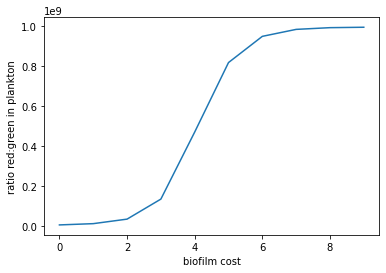

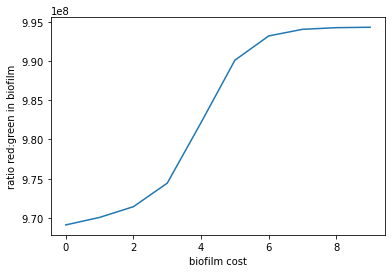

In [17]:
pla_record=[]
bio_record=[]
cost_range=np.linspace(0,1,10)
release_rate = 0.0000001
adhesion=0.00001

print (cost_range)
XX='Cost_'
for i in cost_range:
    
    [plaG,plaR, bioG, bioR]=run_experiment_1(i,release_rate, adhesion)
    pla_record.append(plaG)
    bio_record.append(bioG)

plt.plot(pla_record)
plt.xlabel('biofilm cost')
plt.ylabel('ratio red:green in plankton')
#plt.savefig(XX+'RGRatioPlankton.png',bbox_inches='tight')
plt.show()
plt.plot(bio_record)
plt.xlabel('biofilm cost')
plt.ylabel('ratio red:green in biofilm')
#plt.savefig(XX+'RGRatioBiofilm.png',bbox_inches='tight')
plt.show()

[0, 0]
Start treatment
 
[9.93939394e+08 0.00000000e+00 9.94315284e+08 0.00000000e+00]
End of treatment
[9.93939394e+08 0.00000000e+00 9.94315284e+08 0.00000000e+00]
[0]
Start treatment
 
[0.00000000e+00 3.83399000e+08 9.92966348e+08 1.05708984e+06]
End of treatment
[0, 0]
Start treatment
 
[9.93939827e+08 0.00000000e+00 9.94315284e+08 0.00000000e+00]
End of treatment
[9.93939827e+08 0.00000000e+00 9.94315284e+08 0.00000000e+00]
[0]
Start treatment
 
[9.77989327e+08 1.58716685e+07 9.94156875e+08 1.57681286e+05]
End of treatment
[0, 0]
Start treatment
 


<ipython-input-42-3e345e79890b>:73: RuntimeWarning: divide by zero encountered in double_scalars
  RG_ratio=[second_treatment.final_populations[1]/second_treatment.final_populations[0], second_treatment.final_populations[3]/second_treatment.final_populations[2]]


[9.93943725e+08 0.00000000e+00 9.94315286e+08 0.00000000e+00]
End of treatment
[9.93943725e+08 0.00000000e+00 9.94315286e+08 0.00000000e+00]
[0]
Start treatment
 
[9.83868089e+08 1.00261164e+07 9.94205770e+08 1.09012554e+05]
End of treatment
[0, 0]
Start treatment
 
[9.93982699e+08 0.00000000e+00 9.94315303e+08 0.00000000e+00]
End of treatment
[9.93982699e+08 0.00000000e+00 9.94315303e+08 0.00000000e+00]
[0]
Start treatment
 
[9.87622371e+08 6.32936481e+06 9.94240460e+08 7.44997631e+04]
End of treatment
[0, 0]
Start treatment
 
[9.94372270e+08 0.00000000e+00 9.94315474e+08 0.00000000e+00]
End of treatment
[9.94372270e+08 0.00000000e+00 9.94315474e+08 0.00000000e+00]
[0]
Start treatment
 
[9.90367756e+08 3.98632471e+06 9.94264945e+08 5.02976391e+04]
End of treatment
[0, 0]
Start treatment
 
[9.98251338e+08 0.00000000e+00 9.94317179e+08 0.00000000e+00]
End of treatment
[9.98251338e+08 0.00000000e+00 9.94317179e+08 0.00000000e+00]
[0]
Start treatment
 
[9.95788351e+08 2.45952570e+06 9.942

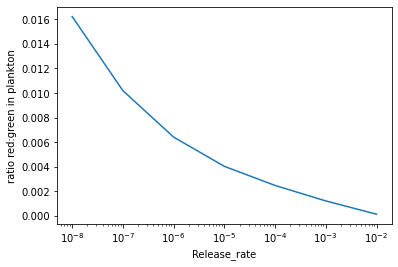

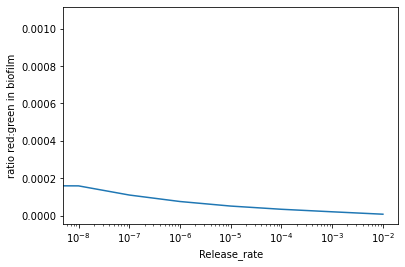

In [44]:
pla_record=[]
bio_record=[]
cost=0.8
release_range = [0.00000001, 0.0000001,0.000001,0.00001,0.0001,0.001,0.01]
adhesion=0.00001


XX='Release_'
for i in release_range:
    
    [pla,bio]=run_experiment_1(cost,i, adhesion)
    pla_record.append(pla)
    bio_record.append(bio)

plt.semilogx(release_range, pla_record)
plt.xlabel('Release_rate')
plt.ylabel('ratio red:green in plankton')
plt.savefig(XX+'RGRatioPlankton.png',bbox_inches='tight')
plt.show()
plt.semilogx(release_range, bio_record)
plt.xlabel('Release_rate')
plt.ylabel('ratio red:green in biofilm')
plt.savefig(XX+'RGRatioBiofilm.png',bbox_inches='tight')
plt.show()


[0, 0]
Start treatment
 
[9.93939394e+08 0.00000000e+00 0.00000000e+00 0.00000000e+00]
End of treatment
[9.93939394e+08 0.00000000e+00 0.00000000e+00 0.00000000e+00]
[0]
Start treatment
 
[0.00000e+00 3.83399e+08 0.00000e+00 0.00000e+00]
End of treatment
[0, 0]
Start treatment
 
[9.93943723e+08 0.00000000e+00 9.93878613e+08 0.00000000e+00]
End of treatment
[9.93943723e+08 0.00000000e+00 9.93878613e+08 0.00000000e+00]
[0]
Start treatment
 
[9.83867651e+08 1.00265508e+07 9.93878503e+08 1.09128884e+02]
End of treatment
[0, 0]
Start treatment
 


<ipython-input-42-3e345e79890b>:73: RuntimeWarning: divide by zero encountered in double_scalars
  RG_ratio=[second_treatment.final_populations[1]/second_treatment.final_populations[0], second_treatment.final_populations[3]/second_treatment.final_populations[2]]
<ipython-input-42-3e345e79890b>:73: RuntimeWarning: invalid value encountered in double_scalars
  RG_ratio=[second_treatment.final_populations[1]/second_treatment.final_populations[0], second_treatment.final_populations[3]/second_treatment.final_populations[2]]


[9.93943723e+08 0.00000000e+00 9.93882549e+08 0.00000000e+00]
End of treatment
[9.93943723e+08 0.00000000e+00 9.93882549e+08 0.00000000e+00]
[0]
Start treatment
 
[9.83867655e+08 1.00265469e+07 9.93881452e+08 1.09127835e+03]
End of treatment
[0, 0]
Start treatment
 
[9.93943723e+08 0.00000000e+00 9.93921904e+08 0.00000000e+00]
End of treatment
[9.93943723e+08 0.00000000e+00 9.93921904e+08 0.00000000e+00]
[0]
Start treatment
 
[9.83867694e+08 1.00265077e+07 9.93910939e+08 1.09117345e+04]
End of treatment
[0, 0]
Start treatment
 
[9.93943725e+08 0.00000000e+00 9.94315286e+08 0.00000000e+00]
End of treatment
[9.93943725e+08 0.00000000e+00 9.94315286e+08 0.00000000e+00]
[0]
Start treatment
 
[9.83868089e+08 1.00261164e+07 9.94205770e+08 1.09012554e+05]
End of treatment
[0, 0]
Start treatment
 
[9.93943742e+08 0.00000000e+00 9.98232122e+08 0.00000000e+00]
End of treatment
[9.93943742e+08 0.00000000e+00 9.98232122e+08 0.00000000e+00]
[0]
Start treatment
 
[9.83872012e+08 1.00222304e+07 9.971

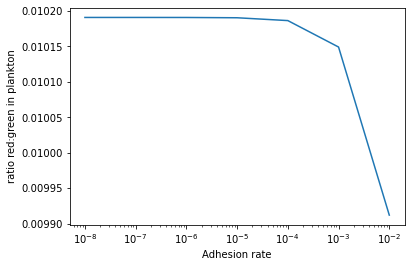

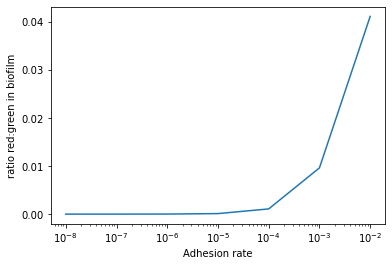

In [45]:
pla_record=[]
bio_record=[]
cost=0.8
release_rate = 0.0000001
adhesion_range=[0,0.00000001, 0.0000001,0.000001,0.00001,0.0001,0.001,0.01]

XX='Adhesion_'
for i in adhesion_range:
    
    [pla,bio]=run_experiment_1(cost,release_rate, i)
    pla_record.append(pla)
    bio_record.append(bio)

plt.semilogx(adhesion_range,pla_record)
plt.xlabel('Adhesion rate')
plt.ylabel('ratio red:green in plankton')
plt.savefig(XX+'RGRatioPlankton.png',bbox_inches='tight')
plt.show()
plt.semilogx(adhesion_range,bio_record)
plt.xlabel('Adhesion rate')
plt.ylabel('ratio red:green in biofilm')
plt.savefig(XX+'RGRatioBiofilm.png',bbox_inches='tight')
plt.show()

[0, 0]
Start treatment
 
[9.93939394e+08 0.00000000e+00 0.00000000e+00 0.00000000e+00]
End of treatment
[9.93939394e+08 0.00000000e+00 0.00000000e+00 0.00000000e+00]
[0]
Start treatment
 
[0.00000000e+00 9.89896417e+08 0.00000000e+00 0.00000000e+00]
End of treatment
[0, 0]
Start treatment
 
[9.93943723e+08 0.00000000e+00 9.93878613e+08 0.00000000e+00]
End of treatment
[9.93943723e+08 0.00000000e+00 9.93878613e+08 0.00000000e+00]
[0]
Start treatment
 
[2.80955724e+08 7.10549475e+08 9.93871794e+08 6.80167507e+03]
End of treatment
[0, 0]
Start treatment
 


<ipython-input-42-3e345e79890b>:73: RuntimeWarning: divide by zero encountered in double_scalars
  RG_ratio=[second_treatment.final_populations[1]/second_treatment.final_populations[0], second_treatment.final_populations[3]/second_treatment.final_populations[2]]
<ipython-input-42-3e345e79890b>:73: RuntimeWarning: invalid value encountered in double_scalars
  RG_ratio=[second_treatment.final_populations[1]/second_treatment.final_populations[0], second_treatment.final_populations[3]/second_treatment.final_populations[2]]


[9.93943723e+08 0.00000000e+00 9.93882549e+08 0.00000000e+00]
End of treatment
[9.93943723e+08 0.00000000e+00 9.93882549e+08 0.00000000e+00]
[0]
Start treatment
 
[2.80956057e+08 7.10549144e+08 9.93814363e+08 6.80150121e+04]
End of treatment
[0, 0]
Start treatment
 
[9.93943723e+08 0.00000000e+00 9.93921904e+08 0.00000000e+00]
End of treatment
[9.93943723e+08 0.00000000e+00 9.93921904e+08 0.00000000e+00]
[0]
Start treatment
 
[2.80959388e+08 7.10545829e+08 9.93240229e+08 6.79976272e+05]
End of treatment
[0, 0]
Start treatment
 
[9.93943725e+08 0.00000000e+00 9.94315286e+08 0.00000000e+00]
End of treatment
[9.93943725e+08 0.00000000e+00 9.94315286e+08 0.00000000e+00]
[0]
Start treatment
 
[2.80992684e+08 7.10512696e+08 9.87516955e+08 6.78238706e+06]
End of treatment
[0, 0]
Start treatment
 
[9.93943742e+08 0.00000000e+00 9.98232122e+08 0.00000000e+00]
End of treatment
[9.93943742e+08 0.00000000e+00 9.98232122e+08 0.00000000e+00]
[0]
Start treatment
 
[2.81323498e+08 7.10183494e+08 9.320

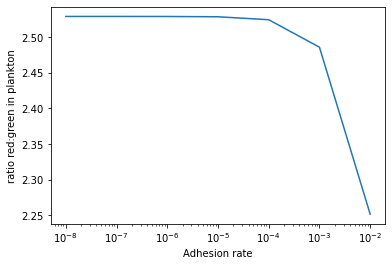

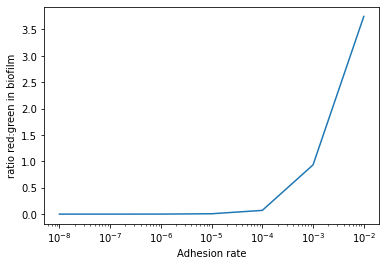

In [46]:
pla_record=[]
bio_record=[]
cost=0.4
release_rate = 0.0000001
adhesion_range=[0,0.00000001, 0.0000001,0.000001,0.00001,0.0001,0.001,0.01]

XX='Adhesion_LessCost'
for i in adhesion_range:
    
    [pla,bio]=run_experiment_1(cost,release_rate, i)
    pla_record.append(pla)
    bio_record.append(bio)

plt.semilogx(adhesion_range,pla_record)
plt.xlabel('Adhesion rate')
plt.ylabel('ratio red:green in plankton')
plt.savefig(XX+'RGRatioPlankton.png',bbox_inches='tight')
plt.show()
plt.semilogx(adhesion_range,bio_record)
plt.xlabel('Adhesion rate')
plt.ylabel('ratio red:green in biofilm')
plt.savefig(XX+'RGRatioBiofilm.png',bbox_inches='tight')
plt.show()

## This is old mix

In [ ]:
name='RG_test_'

####### PROPERTIES OF THE POPULATION ########
N=1000
loci=2
mutation_rate=0.000
cost_vector=[0.0,0.0]   #loc_costs = 0 * c_c * np.random.rand(k) + c_c
benefit_vector=[0,0]  
biofilm_benefit=5
biofilm_cost=0.9
psi_max_s=0.0231 
psi_min=-0.0833
gamma=0.00007
MIC = 1.0

release_rate = 0.00000001
adhesion=0.00001

init_pop=np.zeros(2**loci)
init_pop[0]=N
print (init_pop)
######### PROPERTIES OF THE EXPERIMENT, INCLUDING THE DRUG PARAMETERS #######

kappa=1.5
cycle_length = 1 * 24 * 60  # length of a cycle in minutes
init_conc = 0.5 * MIC  # intitial antibiotic concentration
car_cap=10**9
degradation_rate=-0.000004
concentration_gradient=[0,0]
cycle_number=len(concentration_gradient)

In [74]:
############ Starting population initialization ###############

living_style=0
N=1000000
init_pop=np.zeros(2**loci)
init_pop[1]=N
init_pop[2]=0

my_pla_population=Bacterial_population(init_pop,loci=loci,psi_max_s=psi_max_s, psi_min=psi_min, gamma=gamma, MIC = MIC, cost_vector=cost_vector,benefit_vector=benefit_vector, mutation_rate=mutation_rate, living_style=living_style, biofilm_benefit=biofilm_benefit, biofilm_cost=biofilm_cost, release_rate=release_rate, adhesion=adhesion)

living_style=1
N=0
init_pop=np.zeros(2**loci)
init_pop[1]=0
init_pop[2]=N
my_bio_population=Bacterial_population(init_pop,loci=loci,psi_max_s=psi_max_s, psi_min=psi_min, gamma=gamma, MIC = MIC, cost_vector=cost_vector,benefit_vector=benefit_vector, mutation_rate=mutation_rate, living_style=living_style, biofilm_benefit=biofilm_benefit, biofilm_cost=biofilm_cost, release_rate=release_rate, adhesion=adhesion)

[1000.    0.    0.    0.]
genotypes [[0 0]
 [0 1]
 [1 0]
 [1 1]]
bv [0, 0]
cv [0.0, 0.0]
genotypes [[0 0]
 [0 1]
 [1 0]
 [1 1]]
dep [[], [0], [0], [2, 1]]
MIC [1. 1. 1. 1.]
total cost [0. 0. 0. 0.]
genotypes [[0 0]
 [0 1]
 [1 0]
 [1 1]]
bv [0, 0]
cv [0.0, 0.0]
now I am deifning biofilm
genotypes [[0 0]
 [0 1]
 [1 0]
 [1 1]]
dep [[], [0], [0], [2, 1]]
MIC [6. 6. 6. 6.]
total cost [0.9 0.9 0.9 0.9]


[0, 0]
Start experiment
 
[0.00000000e+00 9.93939410e+08 0.00000000e+00 0.00000000e+00
 0.00000000e+00 7.06724338e+07 0.00000000e+00 0.00000000e+00]
End of experiment


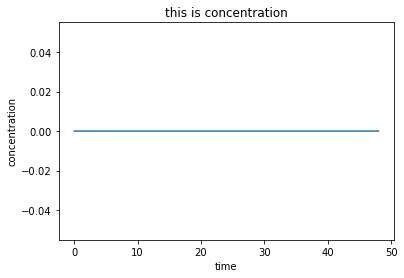

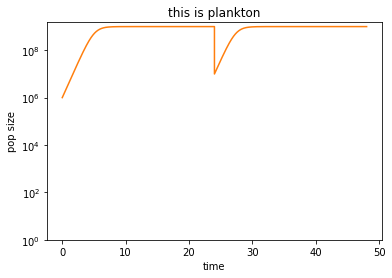

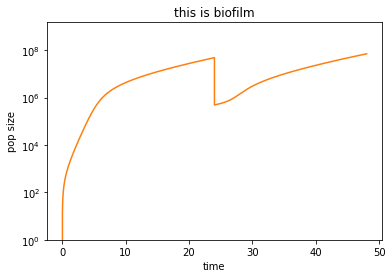

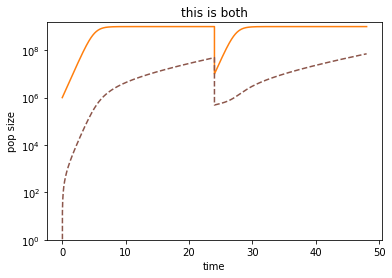

In [75]:
my_experiment=Experiment(concentration_gradient, cycle_length=cycle_length , cycle_number=cycle_number, car_cap=car_cap,kappa=kappa, degradation_rate=degradation_rate)
my_experiment.run_deterministic_simulation(my_pla_population, my_bio_population)
my_experiment.plot_results()

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
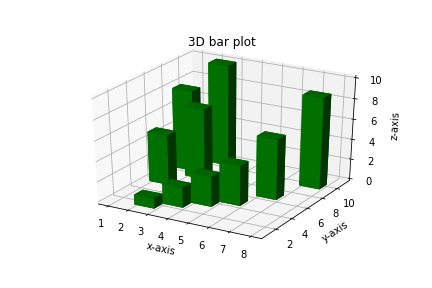

In [31]:
# creating 3d bar plot using matplotlib
# in python

# to interacte with plot
%matplotlib widget

# importing required libraries
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import numpy as np

# creating random dataset
xs = [2, 3, 4, 5, 1, 6, 2, 1, 7, 2]
ys = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
zs = np.zeros(10)
dx = np.ones(10)
dy = np.ones(10)
dz = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]

# creating figure
figg = plt.figure()
ax = figg.add_subplot(111, projection='3d')

# creating the plot
plot_geeks = ax.bar3d(xs, ys, zs, dx,
					dy, dz, color='green')

# setting title and labels
ax.set_title("3D bar plot")
ax.set_xlabel('x-axis')
ax.set_ylabel('y-axis')
ax.set_zlabel('z-axis')

# displaying the plot
plt.show()
